## New York Felony Crime Analysis - Spatio-Temporal Pattern


### 1) Introduction

City crime in New York has long been an issue since 1970s. Appreciation on the spatial and temporal characteristics of crime pattern is believed to contribute to crime reduction and prevention. In this study, the spatial and temporal pattern are analysed to provide insights for police forces. Felony criminal cases, which sentenced for more than one year in jail, are examined. 

A hotspot is a geographical area with higher-than-average crime, as areas of crime concentration across the city [1][2]. Hotspots analysis identifies areas where criminal cases used to take place in, which helped allocate police resources.

In addition, it is crucial to understand crime may not stay in same space but displace from place to place over time. Offenders may change their activities in one area and find new targets in response to police activity [1]. Therefore, it is important to identify hotspots with consideration on temporal change. 

Research questions are developed to investigate spatial and temporal pattern of felony crime in past five years.
(1)	How do numbers of felony crimes changes along timeline?
(2)	Is there a periodicity, or time cycles observed?
(3)	What are the areas where felony crime used to take place in?
(4)	How do the spatial patterns of felony crime displace/ remains over time?

Criminal complaint dataset provided by New York Police Department (NYPD) covers all valid felony cases reported since 2006, with details in accurate and precise locations and start/ end time of occurrence, as well as offense categories and victim profiles. 


In [2]:
# Import python libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import folium as fm
from datetime import datetime as dt
from datetime import timedelta
import datetime
from folium.plugins import HeatMap, MarkerCluster
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
import math
from shapely.geometry import Polygon

In [3]:
# For reproducible results
np.random.seed(123)

In [4]:
%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (15.0, 5.0)

### 2) Data Processing

Import Data from historical data source and YTD data

In [5]:
historic_data = pd.read_csv('Data/NYPD_Complaint_Data_Historic.csv',low_memory=False)
ytd_data = pd.read_csv('Data/NYPD_Complaint_Data_Current__Year_To_Date_.csv')

In [6]:
# Check Data Quality and columns
print(historic_data.head())

   CMPLNT_NUM CMPLNT_FR_DT CMPLNT_FR_TM CMPLNT_TO_DT CMPLNT_TO_TM  \
0   700381962   05/28/2015     15:00:00          NaN          NaN   
1   642234217   10/28/2013     13:50:00   10/28/2013     13:50:00   
2   242465164   05/09/2012     20:50:00   05/09/2012     21:00:00   
3   927207428   01/03/2014     13:30:00   01/03/2014     13:35:00   
4   492142357   04/13/2016     00:00:00          NaN          NaN   

   ADDR_PCT_CD      RPT_DT  KY_CD                       OFNS_DESC  PD_CD  ...  \
0         46.0  06/01/2015    578                   HARRASSMENT 2  638.0  ...   
1        120.0  10/28/2013    351  CRIMINAL MISCHIEF & RELATED OF  259.0  ...   
2         24.0  05/09/2012    236               DANGEROUS WEAPONS  782.0  ...   
3        108.0  01/03/2014    109                   GRAND LARCENY  409.0  ...   
4         40.0  04/13/2016    351  CRIMINAL MISCHIEF & RELATED OF  258.0  ...   

  SUSP_SEX TRANSIT_DISTRICT   Latitude  Longitude  \
0        M              NaN  40.845868 -73.91

In [7]:
historic_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6983207 entries, 0 to 6983206
Data columns (total 35 columns):
 #   Column             Dtype  
---  ------             -----  
 0   CMPLNT_NUM         int64  
 1   CMPLNT_FR_DT       object 
 2   CMPLNT_FR_TM       object 
 3   CMPLNT_TO_DT       object 
 4   CMPLNT_TO_TM       object 
 5   ADDR_PCT_CD        float64
 6   RPT_DT             object 
 7   KY_CD              int64  
 8   OFNS_DESC          object 
 9   PD_CD              float64
 10  PD_DESC            object 
 11  CRM_ATPT_CPTD_CD   object 
 12  LAW_CAT_CD         object 
 13  BORO_NM            object 
 14  LOC_OF_OCCUR_DESC  object 
 15  PREM_TYP_DESC      object 
 16  JURIS_DESC         object 
 17  JURISDICTION_CODE  float64
 18  PARKS_NM           object 
 19  HADEVELOPT         object 
 20  HOUSING_PSA        object 
 21  X_COORD_CD         float64
 22  Y_COORD_CD         float64
 23  SUSP_AGE_GROUP     object 
 24  SUSP_RACE          object 
 25  SUSP_SEX          

In [8]:
print(ytd_data.head())
print(ytd_data.info())

   CMPLNT_NUM  ADDR_PCT_CD    BORO_NM CMPLNT_FR_DT CMPLNT_FR_TM CMPLNT_TO_DT  \
0   797931560           33  MANHATTAN   09/16/2020     00:30:00          NaN   
1   664557183           32  MANHATTAN   06/24/2020     21:20:00   06/24/2020   
2   453437883           47      BRONX   09/28/2020     20:00:00          NaN   
3   949043828           43      BRONX   07/26/2020     01:08:00          NaN   
4   604509546           14  MANHATTAN   09/26/2020     19:30:00          NaN   

  CMPLNT_TO_TM CRM_ATPT_CPTD_CD HADEVELOPT  HOUSING_PSA  ...  \
0          NaN        COMPLETED        NaN          NaN  ...   
1     21:30:00        COMPLETED        NaN          NaN  ...   
2          NaN        COMPLETED        NaN          NaN  ...   
3          NaN        COMPLETED        NaN          NaN  ...   
4          NaN        COMPLETED        NaN          NaN  ...   

   TRANSIT_DISTRICT VIC_AGE_GROUP  VIC_RACE VIC_SEX X_COORD_CD Y_COORD_CD  \
0               NaN           65+     WHITE       F     9

#### Produce Dataset for further pre-processing

In [9]:
# Select attributes applicable to this analysis
col_use = ['CMPLNT_NUM','BORO_NM','CMPLNT_FR_DT','CMPLNT_FR_TM','CMPLNT_TO_DT','CMPLNT_TO_TM','CRM_ATPT_CPTD_CD','KY_CD','LAW_CAT_CD','OFNS_DESC','PD_CD','PD_DESC','PREM_TYP_DESC','RPT_DT','VIC_AGE_GROUP','VIC_RACE','VIC_SEX','X_COORD_CD','Y_COORD_CD','Latitude','Longitude','New Georeferenced Column']

In [10]:
# New Georeferenced Column missing from Historical Data. Fill the column with Latitude and Longitude of the dataset
historic_data['New Georeferenced Column'] = 'POINT ' + historic_data['Lat_Lon']

In [11]:
# Combine the two dataset to 'Crime' and select the columns necessary for analysis
crime = pd.concat([historic_data[col_use],ytd_data[col_use]])

In [12]:
# Subset Felony Crime only
felony = crime[crime.LAW_CAT_CD=='FELONY'].reset_index(drop=True).sort_values(by='CMPLNT_NUM')

In [13]:
# As some data may replicate in both dataset, remove rows that duplicates
print(felony[felony.duplicated(keep=False)].head())
felony = felony.drop_duplicates(keep='first').reset_index(drop=True)

        CMPLNT_NUM BORO_NM CMPLNT_FR_DT CMPLNT_FR_TM CMPLNT_TO_DT  \
287526   100569671   BRONX   10/24/2018     15:58:00          NaN   
230373   100569671   BRONX   10/24/2018     15:58:00          NaN   
129265   100579401  QUEENS   08/01/2017     00:00:00   12/31/2018   
287699   100579401  QUEENS   08/01/2017     00:00:00   12/31/2018   
112827   100986692  QUEENS   06/01/2017     12:00:00   03/20/2019   

       CMPLNT_TO_TM CRM_ATPT_CPTD_CD  KY_CD LAW_CAT_CD  \
287526          NaN        COMPLETED    121     FELONY   
230373          NaN        COMPLETED    121     FELONY   
129265     00:00:00        COMPLETED    104     FELONY   
287699     00:00:00        COMPLETED    104     FELONY   
112827     10:00:00        COMPLETED    112     FELONY   

                             OFNS_DESC  ...         PREM_TYP_DESC      RPT_DT  \
287526  CRIMINAL MISCHIEF & RELATED OF  ...  TRANSIT - NYC SUBWAY  09/05/2019   
230373  CRIMINAL MISCHIEF & RELATED OF  ...  TRANSIT - NYC SUBWAY  09/05/2

In [14]:
# Remove Complaint number where different date of occurance is marked, keep the rows where coordinates are given

## Select index where coordinates are null
index_list = list((felony[(felony.duplicated(subset=['CMPLNT_NUM','CMPLNT_FR_DT'],keep=False)) & (felony.Latitude.isna())]).index.values)

## Drop these index from data
felony=felony.drop(index=index_list[0:],axis=0)

In [15]:
## Some complaint number duplicates because the 6-7th digit of coordinates are different. Remove the last coordinates appear.
print(felony[felony.duplicated(subset=['CMPLNT_NUM','CMPLNT_FR_DT'],keep=False)].head())

felony = felony.drop_duplicates(subset=['CMPLNT_NUM','BORO_NM','CMPLNT_FR_DT','CMPLNT_FR_TM','CMPLNT_TO_DT','CMPLNT_TO_TM','CRM_ATPT_CPTD_CD','KY_CD','LAW_CAT_CD','OFNS_DESC','PD_CD','PD_DESC','PREM_TYP_DESC','RPT_DT','VIC_AGE_GROUP','VIC_RACE','VIC_SEX'],keep='first')

      CMPLNT_NUM   BORO_NM CMPLNT_FR_DT CMPLNT_FR_TM CMPLNT_TO_DT  \
415    100158294    QUEENS   06/01/2011     00:01:00   08/31/2015   
416    100158294    QUEENS   06/01/2011     00:01:00   08/31/2015   
941    100352468    QUEENS   11/01/2018     12:00:00   02/11/2019   
943    100352468    QUEENS   11/01/2018     12:00:00   02/11/2019   
1152   100435467  BROOKLYN   04/14/2012     09:00:00   04/14/2012   

     CMPLNT_TO_TM CRM_ATPT_CPTD_CD  KY_CD LAW_CAT_CD      OFNS_DESC  ...  \
415      23:59:00        COMPLETED    116     FELONY     SEX CRIMES  ...   
416      23:59:00        COMPLETED    116     FELONY     SEX CRIMES  ...   
941      12:00:00        COMPLETED    109     FELONY  GRAND LARCENY  ...   
943      12:00:00        COMPLETED    109     FELONY  GRAND LARCENY  ...   
1152     18:00:00        COMPLETED    109     FELONY  GRAND LARCENY  ...   

        PREM_TYP_DESC      RPT_DT VIC_AGE_GROUP        VIC_RACE VIC_SEX  \
415             OTHER  11/25/2019         18-24  WHIT

#### Handling Missing Values & Data Qualities

In [16]:
## Time of Occurance is missing from several complaints,possibly due to data error. They are first filled by the ending date, 
## if ending date is also missing,they are filled by the date they file the complaint to NYPD

felony.CMPLNT_FR_DT = felony.CMPLNT_FR_DT.copy().fillna(value=felony.CMPLNT_TO_DT)
felony.CMPLNT_FR_DT = felony.CMPLNT_FR_DT.copy().fillna(value=felony.RPT_DT)

In [17]:
## Set Year Column to filter data before 2015
felony['Year']=felony.CMPLNT_FR_DT.copy().str[-4:]

## Assign Datatype to Integar
felony.Year = felony.Year.astype('int64')

## Filter data before 2015
df = felony[felony.Year >= 2015]

In [18]:
# Combine the start and end date and time to two new datatime columns

## Combine date and time of two attributes
df.loc[:,'CMPLNT_FR'] = df['CMPLNT_FR_DT'] + ' ' + df['CMPLNT_FR_TM']
df.loc[:,'CMPLNT_TO'] = df['CMPLNT_TO_DT']  + ' ' + df['CMPLNT_TO_TM']

## Convert datatype to datetime with responding format
df.CMPLNT_FR_DT = pd.to_datetime(df.CMPLNT_FR_DT,format='%m/%d/%Y',errors='coerce')
df.CMPLNT_TO_DT = pd.to_datetime(df.CMPLNT_TO_DT,format='%m/%d/%Y',errors='coerce')
df.CMPLNT_FR = pd.to_datetime(df.CMPLNT_FR,format='%m/%d/%Y %H:%M:%S',errors='coerce')
df.CMPLNT_TO = pd.to_datetime(df.CMPLNT_TO,format='%m/%d/%Y %H:%M:%S',errors='coerce')
df.CMPLNT_FR_TM = pd.to_datetime(df.CMPLNT_FR_TM,format='%H:%M:%S',errors='coerce')
df.CMPLNT_TO_TM = pd.to_datetime(df.CMPLNT_TO_TM,format='%H:%M:%S',errors='coerce')
df.RPT_DT = pd.to_datetime(df.RPT_DT,format='%m/%d/%Y',errors='coerce').copy()

# Select 5 years data before September 2020
df = df[df.CMPLNT_FR_DT >= '2015-10-01 00:00:00'] 

C:\Users\Hillie\anaconda3\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Hillie\anaconda3\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\Users\Hillie\anaconda3\lib\site-packages\pandas\core\generic.py:5168: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] =

In [19]:
# reset index
df.reset_index(drop=True, inplace=True)

# Check columns info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 707090 entries, 0 to 707089
Data columns (total 25 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   CMPLNT_NUM                707090 non-null  int64         
 1   BORO_NM                   705465 non-null  object        
 2   CMPLNT_FR_DT              707090 non-null  datetime64[ns]
 3   CMPLNT_FR_TM              707090 non-null  datetime64[ns]
 4   CMPLNT_TO_DT              619300 non-null  datetime64[ns]
 5   CMPLNT_TO_TM              619544 non-null  datetime64[ns]
 6   CRM_ATPT_CPTD_CD          707090 non-null  object        
 7   KY_CD                     707090 non-null  int64         
 8   LAW_CAT_CD                707090 non-null  object        
 9   OFNS_DESC                 706987 non-null  object        
 10  PD_CD                     705480 non-null  float64       
 11  PD_DESC                   705480 non-null  object        
 12  PR

In [20]:
# Fill in the missing values in BORO_NM by mapping their coordinates system
mapping = crime.loc[(crime.BORO_NM.notna()) & (crime['New Georeferenced Column'].notna()),['Latitude','Longitude','New Georeferenced Column','BORO_NM']].drop_duplicates(subset='New Georeferenced Column',keep='first')
mapped = df.merge(mapping,on='New Georeferenced Column',how='left')
df.BORO_NM = mapped.BORO_NM_x.fillna(value=mapped.BORO_NM_y)

In [21]:
# If there are no exact match, match coordinates rounded to 4 digit
mapping_2 = pd.concat([mapping.BORO_NM, np.round(mapping[['Latitude','Longitude']],4)],axis=1).drop_duplicates(subset=['Latitude','Longitude'],keep='first')
df[['Latitude_round','Longitude_round']] = np.round(df[['Latitude','Longitude']],4)
mapped_2 = df.merge(mapping_2,left_on=['Latitude_round','Longitude_round'],right_on = ['Latitude','Longitude'],how='left')
df.BORO_NM = mapped_2.BORO_NM_x.fillna(value=mapped_2.BORO_NM_y)
df.drop(columns=['Latitude_round','Longitude_round'],inplace=True)

In [22]:
# For rows where end time is given but ending date is missing, fill the missing value by the start date (assume police did not mark down the end date on the same day)
df.loc[(df.CMPLNT_TO_TM.notna()) & (df.CMPLNT_TO_DT.isna()),'CMPLNT_TO_DT']= df.loc[(df.CMPLNT_TO_TM.notna()) & (df.CMPLNT_TO_DT.isna()),'CMPLNT_FR_DT']

In [23]:
# For ros where end time is missing but end date is not missing, assume they are wrongly filled and filled by NaN
df.loc[(df.CMPLNT_TO_TM.isna()) & (df.CMPLNT_TO_DT.notna()),'CMPLNT_TO_DT'] = np.nan

In [24]:
# Missing Offense title is filled according to the KY_CD unique ID
mapping = df.loc[df.OFNS_DESC.notna(),['KY_CD','OFNS_DESC']].drop_duplicates(subset='KY_CD',keep='first')
mapped = df.merge(mapping,on='KY_CD',how='left')
df.OFNS_DESC = mapped.OFNS_DESC_x.fillna(value=mapped.OFNS_DESC_y)

In [25]:
# Missing Offense title is filled according to the PD_CD unique ID
mapping = df.loc[df.OFNS_DESC.notna(),['PD_CD','OFNS_DESC']].drop_duplicates(subset='PD_CD',keep='first')
mapped = df.merge(mapping,on='PD_CD',how='left')
df.OFNS_DESC = mapped.OFNS_DESC_x.fillna(value=mapped.OFNS_DESC_y)

#### Handling Irregular Data/ Re-Categorization

In [26]:
# Group offense with similar natures as Offense Category
offence_dict = {
'RAPE':'RAPE & SEX CRIMES',
'SEX CRIMES':'RAPE & SEX CRIMES',
'FELONY SEX CRIMES':'RAPE & SEX CRIMES',
'KIDNAPPING & RELATED OFFENSES':'KIDNAPPING',
'KIDNAPPING AND RELATED OFFENSES':'KIDNAPPING',
'HOMICIDE-NEGLIGENT-VEHICLE':'HOMICIDE',
'HOMICIDE-NEGLIGENT,UNCLASSIFIE':'HOMICIDE',
'GRAND LARCENY':'GRAND LARCENY & LARCENY OF MOTOR VEHICLE',
'GRAND LARCENY OF MOTOR VEHICLE':'GRAND LARCENY & LARCENY OF MOTOR VEHICLE',
'NYS LAWS-UNCLASSIFIED FELONY':'NYS/ State LAWS-UNCLASSIFIED FELONY',
'OTHER STATE LAWS (NON PENAL LA':'NYS/ State LAWS-UNCLASSIFIED FELONY'
}

df['Offense_Category'] = df.OFNS_DESC.map(offence_dict)
df.Offense_Category = df.Offense_Category.fillna(value=df.OFNS_DESC)
df.Offense_Category.value_counts()

GRAND LARCENY & LARCENY OF MOTOR VEHICLE    240681
FELONY ASSAULT                              102120
ROBBERY                                      69897
MISCELLANEOUS PENAL LAW                      64252
BURGLARY                                     62783
CRIMINAL MISCHIEF & RELATED OF               52541
FORGERY                                      24046
DANGEROUS WEAPONS                            22873
DANGEROUS DRUGS                              22705
THEFT-FRAUD                                  19007
RAPE & SEX CRIMES                            12462
POSSESSION OF STOLEN PROPERTY                 4152
ARSON                                         3742
NYS/ State LAWS-UNCLASSIFIED FELONY           3219
MURDER & NON-NEGL. MANSLAUGHTER               1610
KIDNAPPING                                     626
PROSTITUTION & RELATED OFFENSES                106
CHILD ABANDONMENT/NON SUPPORT                   99
ENDAN WELFARE INCOMP                            68
HOMICIDE                       

In [27]:
# Drop unnecessary columns
df.drop(columns=['KY_CD','LAW_CAT_CD','PD_CD','PD_DESC','Year'],inplace=True)

In [28]:
# Missing values on victim Age Group: Fill with UNKNOWN since unknown initially exist in columns
df.VIC_AGE_GROUP = df.VIC_AGE_GROUP.fillna(value='UNKNOWN')

In [29]:
# Due to presence of different values in Age Group column, assign all abnoraml values to UNKNOWN

Age_Group = { '18-24',
 '25-44',
 '45-64',
 '65+',
 '<18',
 'UNKNOWN'}

df.loc[~df.VIC_AGE_GROUP.isin(Age_Group),'VIC_AGE_GROUP'] = 'UNKNOWN'

In [30]:
# Missing values on victim Race/ Sex: Fill with UNKNOWN/ U

df.VIC_RACE = df.VIC_RACE.fillna(value='UNKNOWN')
df.VIC_SEX = df.VIC_SEX.fillna(value='U')

In [31]:
print(df.head())

   CMPLNT_NUM    BORO_NM CMPLNT_FR_DT        CMPLNT_FR_TM CMPLNT_TO_DT  \
0   100000065  MANHATTAN   2018-09-22 1900-01-01 23:35:00          NaT   
1   100001077     QUEENS   2016-09-13 1900-01-01 09:50:00          NaT   
2   100001361     QUEENS   2020-02-21 1900-01-01 12:00:00   2020-02-21   
3   100003185   BROOKLYN   2016-05-20 1900-01-01 00:05:00          NaT   
4   100006447   BROOKLYN   2018-03-20 1900-01-01 18:30:00   2018-03-22   

         CMPLNT_TO_TM CRM_ATPT_CPTD_CD                       OFNS_DESC  \
0                 NaT        COMPLETED  GRAND LARCENY OF MOTOR VEHICLE   
1                 NaT        COMPLETED                   GRAND LARCENY   
2 1900-01-01 12:01:00        COMPLETED                   GRAND LARCENY   
3                 NaT        COMPLETED                         FORGERY   
4 1900-01-01 07:40:00        COMPLETED                        BURGLARY   

            PREM_TYP_DESC     RPT_DT  ...        VIC_RACE VIC_SEX X_COORD_CD  \
0                  STREET 2018

#### Feature Derivation

In [32]:
# Calculate the total Time span of each criminal complaint for aoristic analysis in minutes
df['Total_time_span'] = (df.CMPLNT_TO - df.CMPLNT_FR).dt.total_seconds()/60

In [33]:
# Show results
df[['CMPLNT_FR','CMPLNT_TO','Total_time_span']].head()

,CMPLNT_FR,CMPLNT_TO,Total_time_span
0,2018-09-22 23:35:00,NaT,NaN
1,2016-09-13 09:50:00,NaT,NaN
2,2020-02-21 12:00:00,2020-02-21 12:01:00,1.0
3,2016-05-20 00:05:00,NaT,NaN
4,2018-03-20 18:30:00,2018-03-22 07:40:00,2230.0


In [34]:
# Calculate the Aoristic Values on different weekdays

## Generate weekday where crime start date is
df['Start_Weekday'] = df.CMPLNT_FR.dt.strftime("%a")

## Generate attributes for each weekday and set initial value = 0
weekday_dict = ['Mon','Tue','Wed','Thu','Fri','Sat','Sun']

for item in weekday_dict:
    df[item]=0

In [35]:
# WARNING: Long Data Processing Time
oneday_min = 24*60

## Fill in the Aoristic values by the total time in one weekday/ total time span
for i in range(0,df.shape[0]):
    weekday = df.Start_Weekday[i]
    timespan = df.Total_time_span.fillna(value=0)[i]
    date = df.CMPLNT_FR[i]
    enddate  = df.CMPLNT_TO.fillna(value=date)[i]
    date_len = (enddate.date() - date.date()).days
    if date_len==0:
        df.loc[i,weekday] = 1
    else:
        date_only = date.date()
        end_date_only= enddate.date()
        end_weekday = end_date_only.strftime("%a")
        date_only = datetime.datetime(date_only.year,date_only.month,date_only.day)
        end_date_only = datetime.datetime(end_date_only.year,end_date_only.month,end_date_only.day)
        df.loc[i,weekday] = (oneday_min - (pd.Timestamp.to_pydatetime(date) - date_only).total_seconds()/60)/timespan
        df.loc[i,end_weekday] = ((pd.Timestamp.to_pydatetime(enddate) - end_date_only).total_seconds()/60)/timespan
        if date_len >1:
            other_weekday = weekday_dict[weekday_dict.index(weekday)+1:weekday_dict.index(end_weekday)]
            df.loc[i,other_weekday] = oneday_min/timespan

In [36]:
# show results
df.head(5)

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Offense_Category,Total_time_span,Start_Weekday,Mon,Tue,Wed,Thu,Fri,Sat,Sun
0,100000065,MANHATTAN,2018-09-22,1900-01-01 23:35:00,NaT,NaT,COMPLETED,GRAND LARCENY OF MOTOR VEHICLE,STREET,2018-09-23,...,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,Sat,0.0,0.000000,0.00000,0.000000,0.0,1.0,0.0
1,100001077,QUEENS,2016-09-13,1900-01-01 09:50:00,NaT,NaT,COMPLETED,GRAND LARCENY,NaN,2016-09-13,...,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,Tue,0.0,1.000000,0.00000,0.000000,0.0,0.0,0.0
2,100001361,QUEENS,2020-02-21,1900-01-01 12:00:00,2020-02-21,1900-01-01 12:01:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2020-08-11,...,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,1.0,Fri,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0
3,100003185,BROOKLYN,2016-05-20,1900-01-01 00:05:00,NaT,NaT,COMPLETED,FORGERY,STREET,2016-05-20,...,FORGERY,NaN,Fri,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0
4,100006447,BROOKLYN,2018-03-20,1900-01-01 18:30:00,2018-03-22,1900-01-01 07:40:00,COMPLETED,BURGLARY,STREET,2018-03-22,...,BURGLARY,2230.0,Tue,0.0,0.147982,0.64574,0.206278,0.0,0.0,0.0


In [37]:
# Drop columns for calculation process only and save a copy (due to the high processing time)
df.drop(columns=['Start_Weekday'],inplace=True)


df.to_csv('Data/NYPD_Complaint_Felony_Clean.csv',index=False)

In [38]:
# Import the CLeaned data 
df = pd.read_csv('Data/NYPD_Complaint_Felony_Clean.csv')

In [39]:
# Assign Datatime Datatype to datetime attributes
df.CMPLNT_FR_DT = pd.to_datetime(df.CMPLNT_FR_DT,format='%Y-%m-%d',errors='coerce')
df.CMPLNT_TO_DT = pd.to_datetime(df.CMPLNT_TO_DT,format='%Y-%m-%d',errors='coerce')
df.CMPLNT_FR = pd.to_datetime(df.CMPLNT_FR,format='%Y-%m-%d %H:%M:%S',errors='coerce')
df.CMPLNT_TO = pd.to_datetime(df.CMPLNT_TO,format='%Y-%m-%d %H:%M:%S',errors='coerce')
df.CMPLNT_FR_TM = pd.to_datetime(df.CMPLNT_FR_TM,format='%Y-%m-%d %H:%M:%S',errors='coerce')
df.CMPLNT_TO_TM = pd.to_datetime(df.CMPLNT_TO_TM,format='%Y-%m-%d %H:%M:%S',errors='coerce')
df.RPT_DT = pd.to_datetime(df.RPT_DT,format='%Y-%m-%d',errors='coerce').copy()

In [40]:
# Check dataset
df.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,CMPLNT_TO,Offense_Category,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun
0,100000065,MANHATTAN,2018-09-22,1900-01-01 23:35:00,NaT,NaT,COMPLETED,GRAND LARCENY OF MOTOR VEHICLE,STREET,2018-09-23,...,NaT,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,0.0,0.000000,0.00000,0.000000,0.0,1.0,0.0
1,100001077,QUEENS,2016-09-13,1900-01-01 09:50:00,NaT,NaT,COMPLETED,GRAND LARCENY,NaN,2016-09-13,...,NaT,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,0.0,1.000000,0.00000,0.000000,0.0,0.0,0.0
2,100001361,QUEENS,2020-02-21,1900-01-01 12:00:00,2020-02-21,1900-01-01 12:01:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2020-08-11,...,2020-02-21 12:01:00,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,1.0,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0
3,100003185,BROOKLYN,2016-05-20,1900-01-01 00:05:00,NaT,NaT,COMPLETED,FORGERY,STREET,2016-05-20,...,NaT,FORGERY,NaN,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0
4,100006447,BROOKLYN,2018-03-20,1900-01-01 18:30:00,2018-03-22,1900-01-01 07:40:00,COMPLETED,BURGLARY,STREET,2018-03-22,...,2018-03-22 07:40:00,BURGLARY,2230.0,0.0,0.147982,0.64574,0.206278,0.0,0.0,0.0


In [41]:
# Understand data properties
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 707090 entries, 0 to 707089
Data columns (total 29 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   CMPLNT_NUM                707090 non-null  int64         
 1   BORO_NM                   707086 non-null  object        
 2   CMPLNT_FR_DT              707090 non-null  datetime64[ns]
 3   CMPLNT_FR_TM              707090 non-null  datetime64[ns]
 4   CMPLNT_TO_DT              619544 non-null  datetime64[ns]
 5   CMPLNT_TO_TM              619544 non-null  datetime64[ns]
 6   CRM_ATPT_CPTD_CD          707090 non-null  object        
 7   OFNS_DESC                 707090 non-null  object        
 8   PREM_TYP_DESC             703097 non-null  object        
 9   RPT_DT                    707090 non-null  datetime64[ns]
 10  VIC_AGE_GROUP             707090 non-null  object        
 11  VIC_RACE                  707090 non-null  object        
 12  VI

#### Handling Outliners

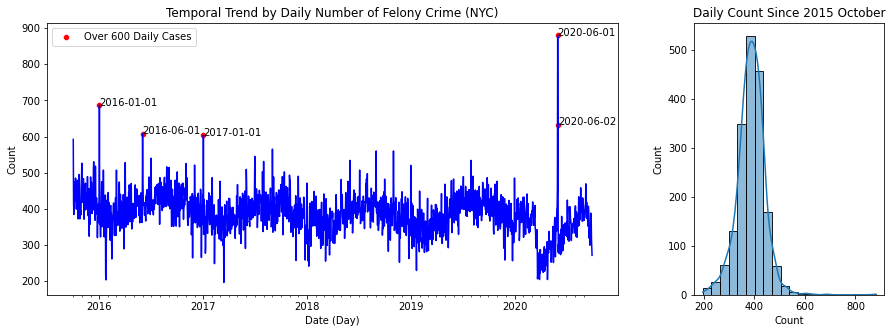

In [42]:
# Find Outliners by current temporal trend (daily count)

date_group = df.groupby(['CMPLNT_FR_DT'])[['CMPLNT_NUM']].count().rename(columns={'CMPLNT_NUM':'Count'}).reset_index()

fig,(ax,ax1) = plt.subplots(ncols=2,figsize=(15,5),gridspec_kw={'width_ratios': [3, 1]})
sns.histplot(date_group.Count,bins=20,kde=True,ax=ax1)

date_group_outliner = date_group.sort_values(by='Count',ascending=False)
date_group_outliner = date_group_outliner[date_group_outliner.Count>600]
sns.lineplot(data=date_group,x='CMPLNT_FR_DT',y='Count',color='b',ax=ax)
sns.scatterplot(data=date_group_outliner,x='CMPLNT_FR_DT',y='Count',color='r',label='Over 600 Daily Cases',ax=ax)
for i,row in date_group_outliner.iterrows():
    ax.text(x=row[0],y=row[1],s=row[0].date())
ax.set_title('Temporal Trend by Daily Number of Felony Crime (NYC)')
ax.set_xlabel('Date (Day)')
xtick = date_group[date_group.CMPLNT_FR_DT.dt.day ==1].CMPLNT_FR_DT
ax.set_xticks(xtick, minor=True)
ax1.set_title('Daily Count Since 2015 October')
plt.show()
fig.savefig('Fig\TemporalTrend_Outliner.png')

##### Short Summary

The distribution showed daily number of felony crime approaches normal and extreme values are mostly larger than 600. These values are thus highlighted in temporal trend. Abnormality is observed in 1-2 Jun 2020 (Mon-Tue) as number soared to 880 and suggested a short-term incident may occur these two days, which resulted in the increase. 

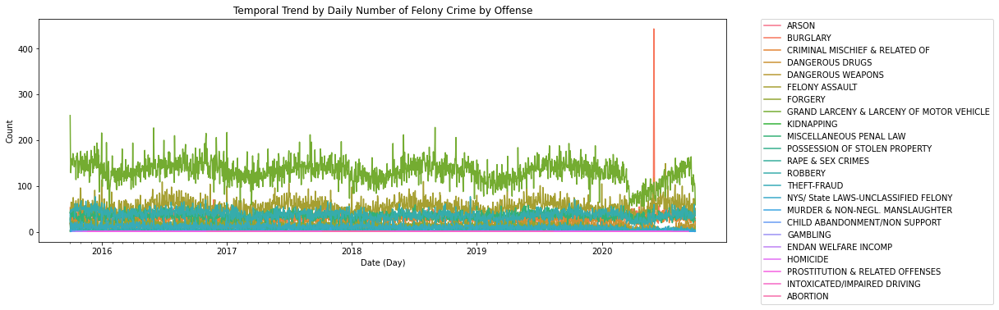

In [43]:
# Show trend outliners by Offense

date_group_offense = df.groupby(['CMPLNT_FR_DT','Offense_Category'])[['CMPLNT_NUM']].count().rename(columns={'CMPLNT_NUM':'Count'}).reset_index()

fig,ax = plt.subplots(figsize=(15,5))
sns.lineplot(data=date_group_offense,x='CMPLNT_FR_DT',y='Count',color='b',ax=ax,hue='Offense_Category')
ax.set_title('Temporal Trend by Daily Number of Felony Crime by Offense')
ax.set_xlabel('Date (Day)')
xtick = date_group[date_group.CMPLNT_FR_DT.dt.day ==1].CMPLNT_FR_DT
ax.set_xticks(xtick, minor=True)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

##### Summary:

While looking into the outliners by Offense, outliners are clear in 1-2 Jun 2020 as well. ‘Burglary’ offense is the major contributor of outliners

In [44]:
# Examine the spatial distribution of temporal outliners
df_JUn2020= df[df.CMPLNT_FR_DT.isin(['2020-06-01','2020-06-02'])]
xmm=(df.Longitude.min()+df.Longitude.max())/2
ymm=(df.Latitude.min()+df.Latitude.max())/2
map = fm.Map(location=[ymm,xmm], zoom_start=10, width=500,height=400,tiles='OpenStreetMap',crs='EPSG3857')
df_JUn2020.apply(lambda row:fm.CircleMarker(location=[row["Latitude"], row["Longitude"]], radius=1, opacity=.2, color='#cc0000').add_to(map), axis=1)

map

# Map suggest the crime are mostly concentrated in Lower Manhattan and upper Manhattan (mostly Harlem District)

In [148]:
# Compare the spatial distribution of same day last year
df_JUn2020_rest= df[df.CMPLNT_FR_DT.isin(['2019-06-01','2019-06-02'])]
xmm=(df.Longitude.min()+df.Longitude.max())/2
ymm=(df.Latitude.min()+df.Latitude.max())/2
map = fm.Map(location=[ymm,xmm], zoom_start=10, width=500,height=400,tiles='OpenStreetMap',crs='EPSG3857')
df_JUn2020_rest.apply(lambda row:fm.CircleMarker(location=[row["Latitude"], row["Longitude"]], radius=1, opacity=.5, color='#cc0000').add_to(map), axis=1)
map

# The map also suggest concentration, though less concentrated as 2020's map

##### Summary:

Compared with last year pattern, crime cases are also concentrated in Lower and Upper Manhattan, yet are more concentrated. No special spatian pattern are spotted from the temporal outliners.

#### Conclusion:

After checking news, 3 changes were found within the season: COVID-19 pandemic, state’s bail reform law since Jan 2020, and mass protests opposed to police brutality on killing of George Floyd. Protests in NYC took place since previous weekend, and curfew was enforced on 1 Jun night. Lootings occurred overnight in Manhattan [7] and may cause the sudden rise of cases.

#### Understanding Offense in NYC

In [46]:
# Create dataset aggregating by offense with temporal trend
date_group_offense = df.groupby(['CMPLNT_FR_DT','Offense_Category'])[['CMPLNT_NUM']].count().rename(columns={'CMPLNT_NUM':'Count'}).reset_index()
date_group_offense['Year'] = date_group_offense.CMPLNT_FR_DT.dt.year

# Less than 1000 in 5 years classify as Other Felony Crime
## Understand the total count of offense
date_group_offense_year =  date_group_offense.groupby(['Offense_Category'])[['Count']].sum().sort_values(by='Count',ascending=False).reset_index()

## Create list with offense title less than 1000
others= list(date_group_offense_year[date_group_offense_year.Count<1000].Offense_Category.values)
print(others)

## Create dictionary which classify Others as "Other Felony"
other_dict = {}

for items in others:
    other_dict[items]='Other Felony'

for category in list(date_group_offense_year[date_group_offense_year.Count>=1000].Offense_Category.values):
    other_dict[category]=category
print(other_dict)

['KIDNAPPING', 'PROSTITUTION & RELATED OFFENSES', 'CHILD ABANDONMENT/NON SUPPORT', 'ENDAN WELFARE INCOMP', 'HOMICIDE', 'GAMBLING', 'INTOXICATED/IMPAIRED DRIVING', 'ABORTION']
{'KIDNAPPING': 'Other Felony', 'PROSTITUTION & RELATED OFFENSES': 'Other Felony', 'CHILD ABANDONMENT/NON SUPPORT': 'Other Felony', 'ENDAN WELFARE INCOMP': 'Other Felony', 'HOMICIDE': 'Other Felony', 'GAMBLING': 'Other Felony', 'INTOXICATED/IMPAIRED DRIVING': 'Other Felony', 'ABORTION': 'Other Felony', 'GRAND LARCENY & LARCENY OF MOTOR VEHICLE': 'GRAND LARCENY & LARCENY OF MOTOR VEHICLE', 'FELONY ASSAULT': 'FELONY ASSAULT', 'ROBBERY': 'ROBBERY', 'MISCELLANEOUS PENAL LAW': 'MISCELLANEOUS PENAL LAW', 'BURGLARY': 'BURGLARY', 'CRIMINAL MISCHIEF & RELATED OF': 'CRIMINAL MISCHIEF & RELATED OF', 'FORGERY': 'FORGERY', 'DANGEROUS WEAPONS': 'DANGEROUS WEAPONS', 'DANGEROUS DRUGS': 'DANGEROUS DRUGS', 'THEFT-FRAUD': 'THEFT-FRAUD', 'RAPE & SEX CRIMES': 'RAPE & SEX CRIMES', 'POSSESSION OF STOLEN PROPERTY': 'POSSESSION OF STOLEN P

In [47]:
# Update the offense category in dataset
df.Offense_Category = df.Offense_Category.map(other_dict)

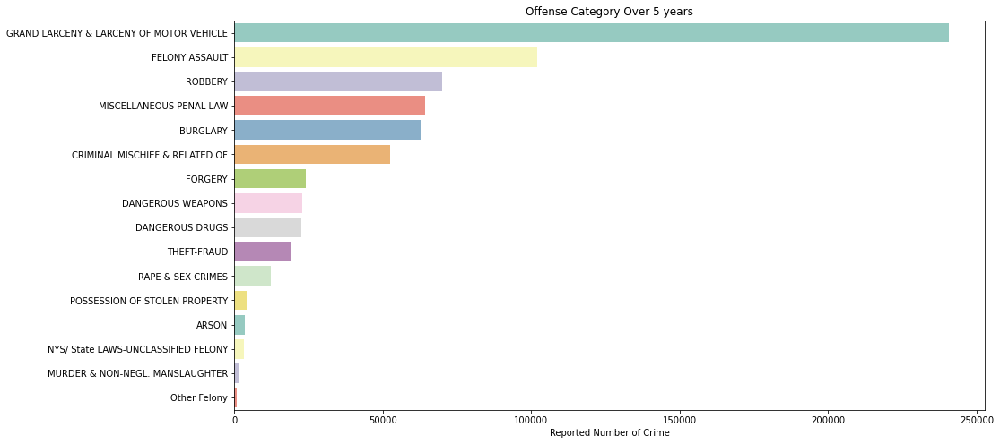

In [49]:
# Aggregate data by complaint number and Offense cateogry with temporal trend
date_group_offense = df.groupby(['CMPLNT_FR_DT','Offense_Category'])[['CMPLNT_NUM']].count().rename(columns={'CMPLNT_NUM':'Count'}).reset_index()
date_group_offense['Year'] = date_group_offense.CMPLNT_FR_DT.dt.year

# Aggregate data by offense category to understand their total count in 5 years
date_group_offense_year =  date_group_offense.groupby(['Offense_Category'])[['Count']].sum().sort_values(by='Count',ascending=False).reset_index()

# Plot bar chart showing total count
fig,ax=plt.subplots(figsize=(15,8))

ax = sns.barplot(x="Count", y="Offense_Category",
  
                data=date_group_offense_year,
                orient="h",  palette="Set3",
                )
ax.set_title('Offense Category Over 5 years')
ax.set_ylabel('')
ax.set_xlabel('Reported Number of Crime')
plt.show()

fig.savefig('Fig\Offense_5years.png')

In [50]:
# show results
df.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,CMPLNT_TO,Offense_Category,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun
0,100000065,MANHATTAN,2018-09-22,1900-01-01 23:35:00,NaT,NaT,COMPLETED,GRAND LARCENY OF MOTOR VEHICLE,STREET,2018-09-23,...,NaT,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,0.0,0.000000,0.00000,0.000000,0.0,1.0,0.0
1,100001077,QUEENS,2016-09-13,1900-01-01 09:50:00,NaT,NaT,COMPLETED,GRAND LARCENY,NaN,2016-09-13,...,NaT,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,0.0,1.000000,0.00000,0.000000,0.0,0.0,0.0
2,100001361,QUEENS,2020-02-21,1900-01-01 12:00:00,2020-02-21,1900-01-01 12:01:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2020-08-11,...,2020-02-21 12:01:00,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,1.0,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0
3,100003185,BROOKLYN,2016-05-20,1900-01-01 00:05:00,NaT,NaT,COMPLETED,FORGERY,STREET,2016-05-20,...,NaT,FORGERY,NaN,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0
4,100006447,BROOKLYN,2018-03-20,1900-01-01 18:30:00,2018-03-22,1900-01-01 07:40:00,COMPLETED,BURGLARY,STREET,2018-03-22,...,2018-03-22 07:40:00,BURGLARY,2230.0,0.0,0.147982,0.64574,0.206278,0.0,0.0,0.0


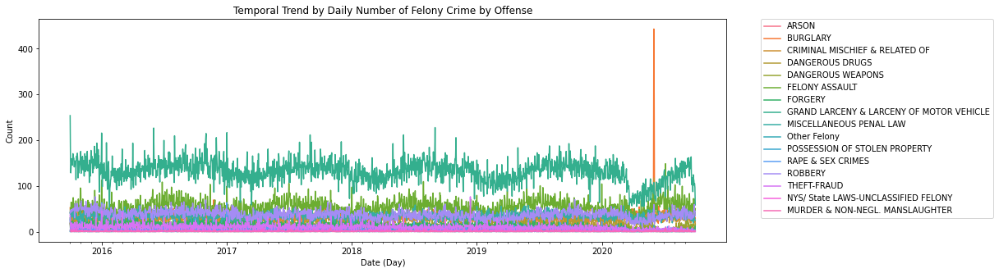

In [51]:
# Find out where the outliners in 1 Jun 2020 are:  trend outliners by offense

date_group_offense = df.groupby(['CMPLNT_FR_DT','Offense_Category'])[['CMPLNT_NUM']].count().rename(columns={'CMPLNT_NUM':'Count'}).reset_index()

# Plot line graph
fig,ax = plt.subplots(figsize=(15,5))
sns.lineplot(data=date_group_offense,x='CMPLNT_FR_DT',y='Count',color='b',ax=ax,hue='Offense_Category')
ax.set_title('Temporal Trend by Daily Number of Felony Crime by Offense')
ax.set_xlabel('Date (Day)')
xtick = date_group[date_group.CMPLNT_FR_DT.dt.day ==1].CMPLNT_FR_DT
ax.set_xticks(xtick, minor=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

# Graph suggest the outliners on 1-2 Jun 2020 are mainly Burglary Crime, which rises suddenly on that day
# May be related with the mass protest on the killing of black in New York. Curfew was implemented on 1 Jun, provoking more massive protest against

In [52]:
# By above conclusion, replace the crime number on 1-2 Jun 2020 from previous day in overall trend

date_group_offense = df.resample('D',on='CMPLNT_FR_DT')[['CMPLNT_FR_DT']].count().rename(columns={'CMPLNT_FR_DT':'Count'}).sort_values(by='CMPLNT_FR_DT').reset_index()
date_group_offense.loc[date_group_offense.CMPLNT_FR_DT.isin(['2020-06-01','2020-06-02']),'Count'] = np.nan
date_group_offense.Count = date_group_offense.Count.fillna(method='ffill')

### 2) Data Analysis in Visual Appraoch and Computational Processing

### Timeline analysis on the date and time of occurance

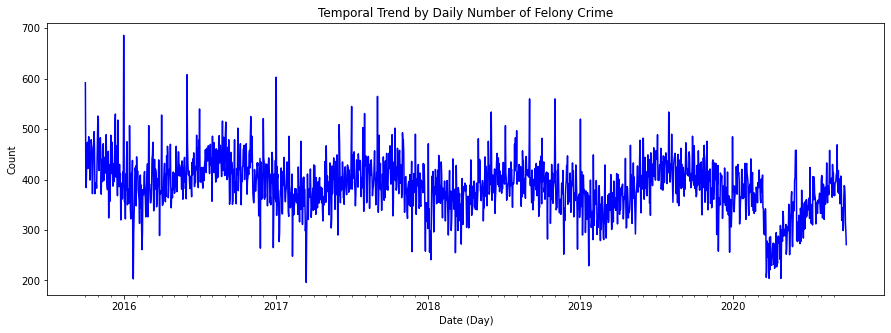

In [58]:
# Plot daily number of felony crime
fig,ax = plt.subplots(figsize=(15,5))
sns.lineplot(data=date_group_offense,x='CMPLNT_FR_DT',y='Count',color='b',ax=ax)
ax.set_title('Temporal Trend by Daily Number of Felony Crime')
ax.set_xlabel('Date (Day)')
xtick = date_group[date_group.CMPLNT_FR_DT.dt.day ==1].CMPLNT_FR_DT
ax.set_xticks(xtick, minor=True)
#ax.legend(loc='upper left',bbox_to_anchor=(0, 1))
#ax.get_legend().remove()
plt.show()
fig.savefig('Fig\TemporalTrend_OutlinerRemoved.jpg')

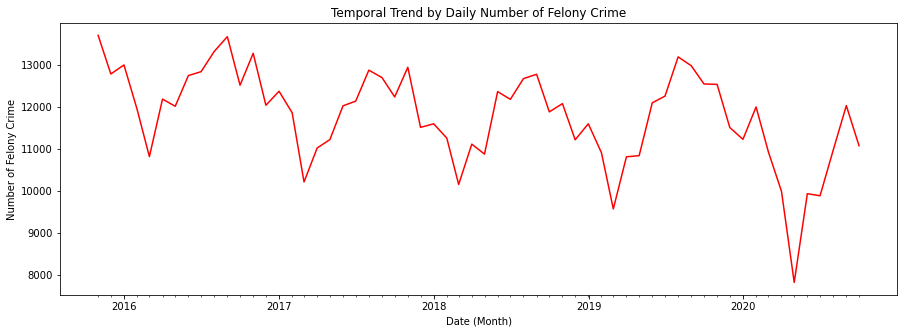

In [53]:
# Temperal Trend by Monthly number

## replace the crime number on 1-2 Jun 2020 from previous day in overall trend
date_group_offense = df.resample('D',on='CMPLNT_FR_DT')[['CMPLNT_FR_DT']].count().rename(columns={'CMPLNT_FR_DT':'Count'}).sort_values(by='CMPLNT_FR_DT').reset_index()
date_group_offense.loc[date_group_offense.CMPLNT_FR_DT.isin(['2020-06-01','2020-06-02']),'Count'] = np.nan
date_group_offense.Count = date_group_offense.Count.fillna(method='ffill')

## Aggregate by month
date_group_offense = date_group_offense.resample('M',on='CMPLNT_FR_DT')[['Count']].sum().sort_values(by='CMPLNT_FR_DT').reset_index()

## plot line graph showing overall monthly number
fig,ax = plt.subplots(figsize=(15,5))
sns.lineplot(data=date_group_offense,x='CMPLNT_FR_DT',y='Count',color='r',ax=ax)
ax.set_title('Temporal Trend by Daily Number of Felony Crime')
ax.set_xlabel('Date (Month)')
xtick = date_group_offense['CMPLNT_FR_DT']
ax.set_xticks(xtick, minor=True)
ax.set_ylabel('Number of Felony Crime')
plt.show()
fig.savefig('Fig\TemporalTrend_OutlinerRemoved_Month.jpg')

In [54]:
# Temporal Trend by Month by Offense

## replace the Burglary me number on 1-2 Jun 2020 from other day (before and after) 
Outliner_date = ['2020-06-01','2020-06-02']
ffill_date = ['2020-05-31','2020-06-03']
map_dict = dict(zip(ffill_date, Outliner_date))

date_group_offense = df.groupby(['Offense_Category','BORO_NM']).resample('D',on='CMPLNT_FR_DT')[['CMPLNT_FR_DT']].count().rename(columns={'CMPLNT_FR_DT':'Count'}).sort_values(by='CMPLNT_FR_DT').reset_index()

## Set up mapping list 
mapping = date_group_offense.loc[date_group_offense.CMPLNT_FR_DT.isin(ffill_date),:].reset_index(drop=True)
mapping.CMPLNT_FR_DT = mapping.CMPLNT_FR_DT.dt.strftime('%Y-%m-%d').map(map_dict).astype('datetime64[ns]')

## Update the number
date_group_offense = date_group_offense.merge(mapping,on=['Offense_Category','BORO_NM','CMPLNT_FR_DT'],how='left')
date_group_offense.loc[(date_group_offense.CMPLNT_FR_DT.isin(Outliner_date)) & (date_group_offense.Offense_Category =='BURGLARY') ,'Count_x'] = np.nan
date_group_offense.Count_x = date_group_offense.Count_x.fillna(value=date_group_offense.Count_y)

# Drop columns and show results
date_group_offense = date_group_offense.drop(columns='Count_y').rename(columns={'Count_x':'Count'}).reset_index(drop=True)
date_group_offense.head(5)

,Offense_Category,BORO_NM,CMPLNT_FR_DT,Count
0,BURGLARY,QUEENS,2015-10-01,10.0
1,THEFT-FRAUD,BROOKLYN,2015-10-01,14.0
2,THEFT-FRAUD,QUEENS,2015-10-01,7.0
3,FORGERY,MANHATTAN,2015-10-01,4.0
4,FORGERY,BRONX,2015-10-01,14.0


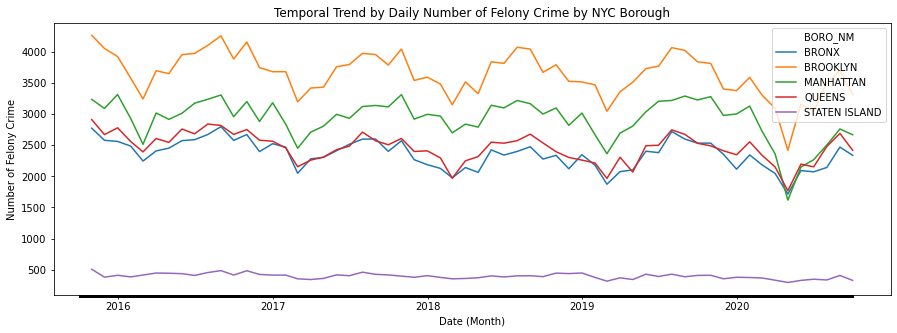

In [146]:
# Aggregate by offense or borough 
offense_trend = date_group_offense.groupby(['Offense_Category']).resample('M',on='CMPLNT_FR_DT')['Count'].sum().reset_index()
borough_trend = date_group_offense.groupby(['BORO_NM']).resample('M',on='CMPLNT_FR_DT')['Count'].sum().reset_index()

# Plot line graph by borough
fig,ax = plt.subplots(figsize=(15,5))
sns.lineplot(data=borough_trend,x='CMPLNT_FR_DT',y='Count',color='r',ax=ax,hue='BORO_NM')
ax.set_title('Temporal Trend by Daily Number of Felony Crime by NYC Borough')
ax.set_xlabel('Date (Month)')
xtick = date_group_offense['CMPLNT_FR_DT']
ax.set_xticks(xtick, minor=True)
ax.set_ylabel('Number of Felony Crime')
plt.show()
fig.savefig('Fig\TemporalTrend_OutlinerRemoved_Month_byBorough')

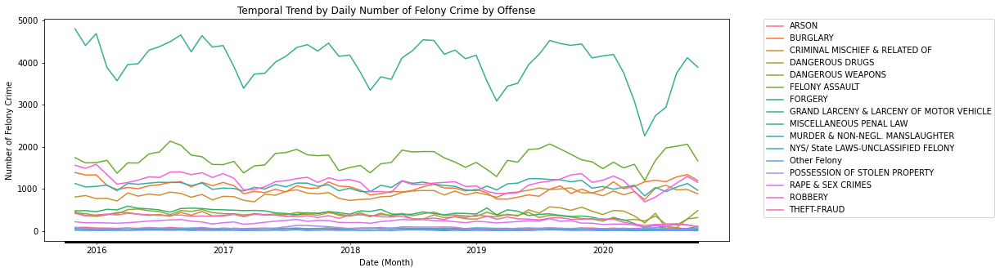

In [145]:
# Plot line graph by offense 
fig,ax = plt.subplots(figsize=(15,5))
sns.lineplot(data=offense_trend,x='CMPLNT_FR_DT',y='Count',color='r',ax=ax,hue='Offense_Category')
ax.set_title('Temporal Trend by Daily Number of Felony Crime by Offense')
ax.set_xlabel('Date (Month)')
xtick = date_group_offense['CMPLNT_FR_DT']
ax.set_xticks(xtick, minor=True)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
ax.set_ylabel('Number of Felony Crime')
plt.show()

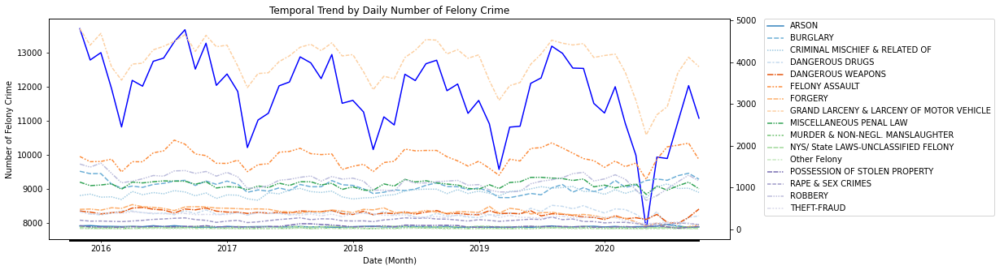

In [57]:
# Plot line graph by offense and add overall trend

trend = date_group_offense.resample('M',on='CMPLNT_FR_DT')['Count'].sum().reset_index()
## set up paletter (categorical palette)
palette = sns.color_palette("tab20c", 16)

fig,ax = plt.subplots(figsize=(15,5))
ax2 = ax.twinx()
sns.lineplot(data=trend,x='CMPLNT_FR_DT',y='Count',color='b',ax=ax)
sns.lineplot(data=offense_trend,x='CMPLNT_FR_DT',y='Count',color='r',ax=ax2,hue='Offense_Category',palette=palette,style="Offense_Category")
ax.set_title('Temporal Trend by Daily Number of Felony Crime')
ax.set_xlabel('Date (Month)')
xtick = date_group_offense['CMPLNT_FR_DT']
ax.set_xticks(xtick, minor=True)
ax.set_ylabel('Number of Felony Crime')
ax2.set_ylabel('')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
fig.savefig('Fig\TemporalTrend_OutlinerRemoved_Month.jpg')

### Seasonality Analysis
#### Year Vs. Week Number

In [58]:
# Aggregate total trend by day
periodicity = date_group_offense.resample('D',on='CMPLNT_FR_DT')['Count'].sum().reset_index()

periodicity['year'] = periodicity.CMPLNT_FR_DT.dt.year
periodicity['week'] = periodicity.CMPLNT_FR_DT.dt.isocalendar().week
periodicity['month'] = periodicity.CMPLNT_FR_DT.dt.month

periodicity.head()

,CMPLNT_FR_DT,Count,year,week,month
0,2015-10-01,592.0,2015,40,10
1,2015-10-02,420.0,2015,40,10
2,2015-10-03,384.0,2015,40,10
3,2015-10-04,426.0,2015,40,10
4,2015-10-05,445.0,2015,41,10


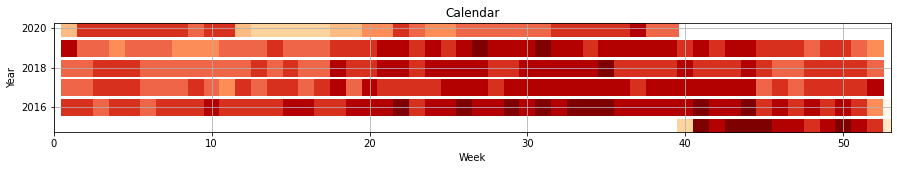

In [59]:
periodicity_week_year = periodicity.groupby(['year','week'])['Count'].sum().reset_index()

# Drop the last week
periodicity_week_year =periodicity_week_year.drop(index=periodicity_week_year.shape[0]-1)

# Color palette
palette = ['#fff7ec','#fee8c8','#fdd49e','#fdbb84','#fc8d59','#ef6548','#d7301f','#b30000','#7f0000']

# Assign color by count
# Set up normalise parameter
count_mean = periodicity_week_year.Count.mean()
std = periodicity_week_year.Count.std()

no = (len(palette)-1)
periodicity_week_year['ColorID'] =(((periodicity_week_year.Count -count_mean)/std))
periodicity_week_year['ColorID'] = np.ceil((periodicity_week_year['ColorID']+abs(periodicity_week_year['ColorID'].min()))/no*10).astype('int64')
periodicity_week_year.ColorID.unique()

Color=[]

for id in periodicity_week_year.ColorID:
    Color.append(palette[id])
    
periodicity_week_year['Color'] = Color


# Plot heatmap by total count (year Vs. Week)
fig=plt.figure(figsize=(15,2))
plt.xlabel('Week')
plt.ylabel('Year')
plt.title('Calendar')
colors = [(0,0,0)]

for id,row in periodicity_week_year.iterrows():
    plt.scatter(row['week'],row['year'],alpha = 1, s=250, marker='s',c=row['Color'])

plt.xlim([0,periodicity_week_year.week.max()])
plt.grid()
    
plt.show()   
fig.savefig('Fig\TemporalHeatmap_Week_Year_byValue.jpg')

#d7301f    17
#b30000    15
#ef6548    14
#7f0000     7
#fdbb84     4
#fc8d59     2
#fff7ec     1
Name: Color, dtype: int64


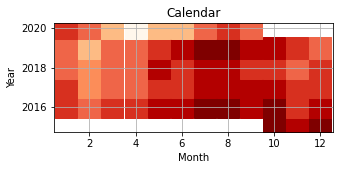

In [60]:
periodicity_month_year = periodicity.groupby(['year','month'])['Count'].sum().reset_index()


# Assign color by count
palette = ['#fff7ec','#fee8c8','#fdd49e','#fdbb84','#fc8d59','#ef6548','#d7301f','#b30000','#7f0000']
no=(len(palette)-1)
periodicity_month_year['ColorID'] = np.ceil((periodicity_month_year.Count - periodicity_month_year.Count.min())/((periodicity_month_year.Count.max()-periodicity_month_year.Count.min())/no)).astype('int64')
Color=[]
for id in periodicity_month_year.ColorID:
    Color.append(palette[id])
periodicity_month_year['Color'] = Color

print(periodicity_month_year.Color.value_counts())

# Plot heatmap by total count (year Vs. Month)
fig = plt.figure(figsize=(5,2))
plt.xlabel('Month')
plt.ylabel('Year')
plt.title('Calendar')
colors = [(0,0,0)]

for id,row in periodicity_month_year.iterrows():
    plt.scatter(row['month'],row['year'],alpha = 1, s=450, marker='s',c=row['Color'])

plt.grid()
    
plt.show()  

fig.savefig('Fig\TemporalHeatmap_Month_Year_byValue.jpg')

In [143]:
# Since the pattern is not clear enough, try K-mean clustering to categorize the pattern
counts_columns = ['Count']
wd_counts=periodicity_week_year.loc[:,counts_columns]

scaler = MinMaxScaler()
wd_counts_scaled=scaler.fit_transform(wd_counts)

K = 6 # Change this value to experiment with different numbers of clusters
kmeans_wd = KMeans(n_clusters=K, random_state=10)

# Fitting the algorithm to the data
kmeans_wd = kmeans_wd.fit(wd_counts_scaled)

# Getting the Cluster labels for the dataframe
labels = kmeans_wd.predict(wd_counts_scaled)

clust_id_col_name='Clusterid'
periodicity_week_year[clust_id_col_name]=labels

# Gettinc cluster sizes
cluster_sizes = periodicity_week_year['Clusterid'].value_counts().rename_axis('Cluster id').to_frame('counts')
print("Cluster sizes:")
print(cluster_sizes)

max_cluster_size=cluster_sizes['counts'].max()
print("max = ",max_cluster_size)

# Getting the Centroid values
centroids = kmeans_wd.cluster_centers_

print("\nCluster centroids:")
print(centroids)


Cluster sizes:
            counts
Cluster id        
1               85
0               74
3               58
5               29
4                8
2                8
max =  85

Cluster centroids:
[[0.66305796]
 [0.77475087]
 [0.38364023]
 [0.89401192]
 [0.16203966]
 [0.54408518]]


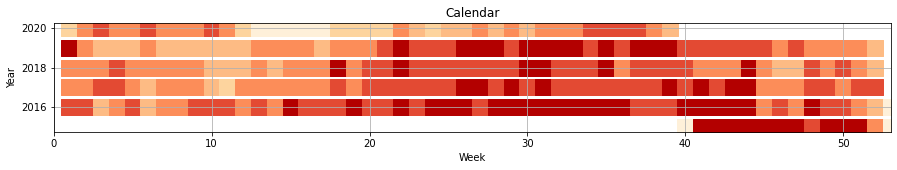

    Clusterid    Color
0           4  #fef0d9
1           3  #b30000
8           1  #e34a33
12          0  #fc8d59
16          5  #fdbb84
77          2  #fdd49e


In [144]:
centroids_list = []
palette = ['#fef0d9','#fdd49e','#fdbb84','#fc8d59','#e34a33','#b30000']

# Color the palette by the centroids' value
for k in centroids:
    centroids_list.append(k[0])
    
centroids_list_sort = sorted(centroids_list)
i=0
centroids_dict = {}
for k in centroids:
    centroids_dict[i]=k[0]
    i=i+1

mapping = dict(zip(centroids_list_sort,palette))

for key, item in centroids_dict.items():
    for k, i in mapping.items():
        if item == k:
            centroids_dict[key] = i
            
periodicity_week_year['Color'] = periodicity_week_year.Clusterid.map(centroids_dict)


# Plot graph by Year Vs. Week
fig = plt.figure(figsize=(15,2),frameon=False)
plt.xlabel('Week')
plt.ylabel('Year')
plt.title('Calendar')
colors = [(0,0,0)]

for id,row in periodicity_week_year.iterrows():
    plt.scatter(row['week'],row['year'],alpha = 1, s=250, marker='s',c=row['Color'])

plt.xlim([0,periodicity_week_year.week.max()])

plt.grid(b=True,which='both')
    
plt.show()  
print(periodicity_week_year[['Clusterid','Color']].drop_duplicates(keep='first'))
fig.savefig('Fig\TemporalHeatmap_Week_Year_byCluster')

Cluster sizes:
            counts
Cluster id        
0               20
1               18
3               15
4                6
2                1
max =  20

Cluster centroids:
[[0.738508  ]
 [0.56406185]
 [0.        ]
 [0.8858115 ]
 [0.36338891]]
#fef0d9    20
#fdd49e    18
#fc8d59    15
#e34a33     6
#fdbb84     1
Name: Color, dtype: int64


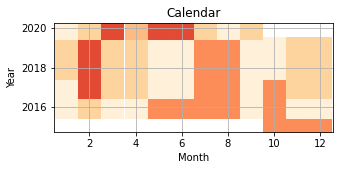

In [63]:
counts_columns = ['Count']
wd_counts=periodicity_month_year.loc[:,counts_columns]

scaler = MinMaxScaler()
wd_counts_scaled=scaler.fit_transform(wd_counts)

K = 5 # Change this value to experiment with different numbers of clusters
kmeans_wd = KMeans(n_clusters=K, random_state=10)

# Fitting the algorithm to the data
kmeans_wd = kmeans_wd.fit(wd_counts_scaled)

# Getting the Cluster labels for the dataframe
labels = kmeans_wd.predict(wd_counts_scaled)

clust_id_col_name='Clusterid'
periodicity_month_year[clust_id_col_name]=labels

# Gettinc cluster sizes
cluster_sizes = periodicity_month_year['Clusterid'].value_counts().rename_axis('Cluster id').to_frame('counts')
print("Cluster sizes:")
print(cluster_sizes)

max_cluster_size=cluster_sizes['counts'].max()
print("max = ",max_cluster_size)

# Getting the Centroid values
centroids = kmeans_wd.cluster_centers_

print("\nCluster centroids:")
print(centroids)

# Color the palette by the centroids' value
Color=[]
for id in periodicity_month_year.Clusterid:
    Color.append(palette[id])
periodicity_month_year['Color'] = Color
print(periodicity_month_year.Color.value_counts())

# Plot graph by Year Vs. Month
plt.figure(figsize=(5,2))
plt.xlabel('Month')
plt.ylabel('Year')
plt.title('Calendar')
colors = [(0,0,0)]

for id,row in periodicity_month_year.iterrows():
    plt.scatter(row['month'],row['year'],alpha = 1, s=450, marker='s',c=row['Color'])

plt.grid()
    
plt.show()  

#### Hour of Day Vs. Weekdays

In [64]:
# Create Hour to understand the hour of occurance
df_hour = df.copy()

df_hour['hour'] = df_hour.CMPLNT_FR.dt.hour
df_hour.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Offense_Category,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,hour
0,100000065,MANHATTAN,2018-09-22,1900-01-01 23:35:00,NaT,NaT,COMPLETED,GRAND LARCENY OF MOTOR VEHICLE,STREET,2018-09-23,...,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,0.0,0.000000,0.00000,0.000000,0.0,1.0,0.0,23
1,100001077,QUEENS,2016-09-13,1900-01-01 09:50:00,NaT,NaT,COMPLETED,GRAND LARCENY,NaN,2016-09-13,...,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,NaN,0.0,1.000000,0.00000,0.000000,0.0,0.0,0.0,9
2,100001361,QUEENS,2020-02-21,1900-01-01 12:00:00,2020-02-21,1900-01-01 12:01:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2020-08-11,...,GRAND LARCENY & LARCENY OF MOTOR VEHICLE,1.0,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0,12
3,100003185,BROOKLYN,2016-05-20,1900-01-01 00:05:00,NaT,NaT,COMPLETED,FORGERY,STREET,2016-05-20,...,FORGERY,NaN,0.0,0.000000,0.00000,0.000000,1.0,0.0,0.0,0
4,100006447,BROOKLYN,2018-03-20,1900-01-01 18:30:00,2018-03-22,1900-01-01 07:40:00,COMPLETED,BURGLARY,STREET,2018-03-22,...,BURGLARY,2230.0,0.0,0.147982,0.64574,0.206278,0.0,0.0,0.0,18


In [65]:
weekday_list = ['Mon','Tue','Wed','Thu','Fri','Sat','Sun']

# Select the aoristic values calculated before and sum up
df_hour_group = df_hour.groupby('hour')[weekday_list].sum().reset_index()
df_hour_group.head()

,hour,Mon,Tue,Wed,Thu,Fri,Sat,Sun
0,0,4295.563639,4159.143138,4676.987197,4528.745913,4816.222421,5594.391477,5413.603186
1,1,3058.760307,2907.255485,3255.635551,3180.096110,3497.467768,4933.038195,4920.048032
2,2,2585.685940,2394.540319,2611.524118,2775.108020,2972.966149,4546.899933,4582.519553
3,3,2251.587671,2013.024131,2182.028415,2184.035059,2502.394952,4110.591985,4389.328996
4,4,2029.695963,1747.904830,1795.079896,1929.007469,2130.777718,3622.406780,3935.545704


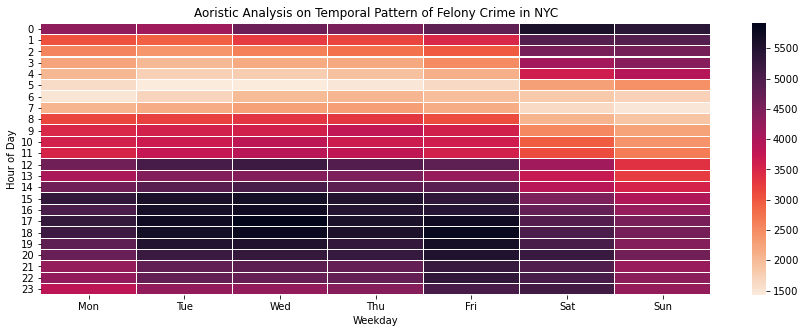

In [141]:
# Heatmap showing Temporal pattern of crime by hour of day and weekday
# Color map choice
colormap=sns.cm.rocket_r

max_value = df_hour_group[weekday_list].max().max()
min_value = df_hour_group[weekday_list].min().min()
fig,ax=plt.subplots()
sns.heatmap(df_hour_group[weekday_list],vmin=min_value,vmax=max_value,linewidths=.1,cmap=colormap)
plt.ylabel('Hour of Day')
plt.xlabel('Weekday')
plt.title('Aoristic Analysis on Temporal Pattern of Felony Crime in NYC')
plt.show()
fig.savefig('Fig\WeekendWeekday_Overall_Details.jpg')

In [67]:
# Aggregate vertically for weekday Vs. Weekend comparison

weekday = weekday_list[0:5]
weekend = weekday_list[6:8]

df_hour_group_weekend = df_hour_group.copy()
df_hour_group_weekend['Weekday'] = df_hour_group_weekend[weekday].sum(axis=1)/len(weekday)
df_hour_group_weekend['Weekend'] = df_hour_group_weekend[weekend].sum(axis=1)/len(weekend)

df_hour_group_weekend.head()

,hour,Mon,Tue,Wed,Thu,Fri,Sat,Sun,Weekday,Weekend
0,0,4295.563639,4159.143138,4676.987197,4528.745913,4816.222421,5594.391477,5413.603186,4495.332461,5413.603186
1,1,3058.760307,2907.255485,3255.635551,3180.096110,3497.467768,4933.038195,4920.048032,3179.843044,4920.048032
2,2,2585.685940,2394.540319,2611.524118,2775.108020,2972.966149,4546.899933,4582.519553,2667.964909,4582.519553
3,3,2251.587671,2013.024131,2182.028415,2184.035059,2502.394952,4110.591985,4389.328996,2226.614046,4389.328996
4,4,2029.695963,1747.904830,1795.079896,1929.007469,2130.777718,3622.406780,3935.545704,1926.493175,3935.545704


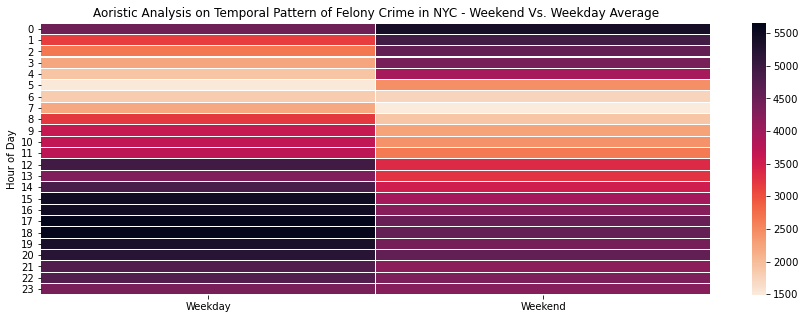

In [140]:
# Plot heat map showing hour of day changes with weekday/weekend
max_value = df_hour_group_weekend[['Weekday','Weekend']].max().max()
min_value = df_hour_group_weekend[['Weekday','Weekend']].min().min()

fig,ax=plt.subplots()
sns.heatmap(df_hour_group_weekend[['Weekday','Weekend']],vmin=min_value,vmax=max_value,linewidths=.1,cmap=colormap,ax=ax)
plt.ylabel('Hour of Day')
plt.title('Aoristic Analysis on Temporal Pattern of Felony Crime in NYC - Weekend Vs. Weekday Average')
plt.show()
fig.savefig('Fig\WeekendWeekday_Overall.jpg')

In [69]:
# Understand weekend Vs weekday by offense category

df_hour_group_offense = df_hour.groupby(['hour','Offense_Category'])[weekday_list].sum().reset_index()
df_hour_group_offense['Weekday']  = df_hour_group_offense[weekday].sum(axis=1)/len(weekday)
df_hour_group_offense['Weekend'] = df_hour_group_offense[weekend].sum(axis=1)/len(weekend)

df_hour_group_offense.head()

,hour,Offense_Category,Mon,Tue,Wed,Thu,Fri,Sat,Sun,Weekday,Weekend
0,0,ARSON,49.372631,38.025510,32.100145,25.009717,30.097963,26.063559,42.147106,34.921193,42.147106
1,0,BURGLARY,389.919746,443.410051,351.501206,311.381400,312.516853,321.020817,325.442512,361.745851,325.442512
2,0,CRIMINAL MISCHIEF & RELATED OF,322.842693,304.366075,309.456134,275.670606,343.424492,426.382806,483.389958,311.152000,483.389958
3,0,DANGEROUS DRUGS,63.001500,65.216073,207.631390,210.571038,214.966323,300.037482,183.024055,152.277265,183.024055
4,0,DANGEROUS WEAPONS,93.000000,99.212070,250.062462,236.375946,252.274932,384.605506,296.041522,186.185082,296.041522


In [70]:
# Select offense which are sensitive to space and time
offense_list = list(df.Offense_Category.unique())
notconcern = ['DANGEROUS DRUGS','FORGERY','Other Felony','POSSESSION OF STOLEN PROPERTY','MISCELLANEOUS PENAL LAW','NYS/ State LAWS-UNCLASSIFIED FELONY']
for n in notconcern:
    offense_list.remove(n)
offense_list

['GRAND LARCENY & LARCENY OF MOTOR VEHICLE',
 'BURGLARY',
 'RAPE & SEX CRIMES',
 'DANGEROUS WEAPONS',
 'CRIMINAL MISCHIEF & RELATED OF',
 'FELONY ASSAULT',
 'ROBBERY',
 'THEFT-FRAUD',
 'ARSON',
 'MURDER & NON-NEGL. MANSLAUGHTER']

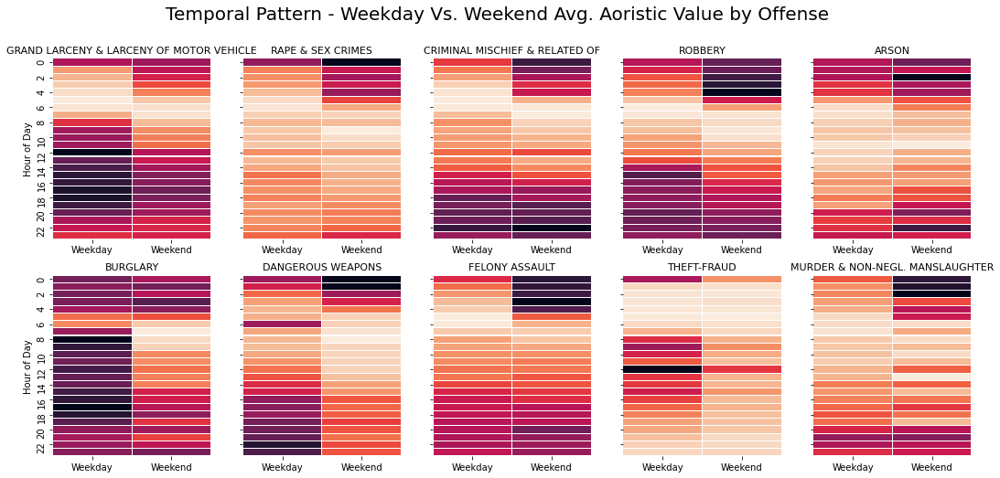

In [71]:
# plot heatmap on weekday and weekend difference by offense category
fig,ax = plt.subplots(ncols=5,nrows=2,figsize=(18,8))

idx=0
for i in range(0,5):
    for j in range(0,2):
        offense = offense_list[idx]
        if idx < len(offense_list)-1:
            idx=idx+1
        data = df_hour_group_offense.loc[df_hour_group_offense.Offense_Category == offense,['Weekday','Weekend']].reset_index(drop=True)
        sns.heatmap(data,linewidths=.05,cmap=colormap,cbar=False,ax=ax[j,i])
        ax[j,i].set_title(offense, fontsize=11)
        if i==0:
            ax[j,i].set_ylabel('Hour of Day')
        else:
            ax[j,i].set_yticklabels('')
plt.suptitle('Temporal Pattern - Weekday Vs. Weekend Avg. Aoristic Value by Offense',fontsize=20)
plt.show()

fig.savefig('Fig\WeekendWeekday_byOffense.jpg')

In [72]:
# Understand weekend Vs weekday by borough
df_hour_group_borough = df_hour.groupby(['hour','BORO_NM'])[weekday_list].sum().reset_index()
df_hour_group_borough['Weekday']  = df_hour_group_borough[weekday].sum(axis=1)/len(weekday)
df_hour_group_borough['Weekend'] = df_hour_group_borough[weekend].sum(axis=1)/len(weekend)

df_hour_group_borough.head()

,hour,BORO_NM,Mon,Tue,Wed,Thu,Fri,Sat,Sun,Weekday,Weekend
0,0,BRONX,882.611570,878.925076,998.593563,898.446720,1039.916123,1126.276630,1059.996520,939.698611,1059.996520
1,0,BROOKLYN,1373.312370,1298.019830,1528.803370,1457.358913,1555.610586,1798.902444,1827.667551,1442.621014,1827.667551
2,0,MANHATTAN,980.998171,897.343667,1017.138960,1044.088418,1117.301231,1367.196144,1240.998029,1011.374089,1240.998029
3,0,QUEENS,915.214611,910.181539,971.341485,972.943807,944.458599,1120.215345,1133.501520,942.828008,1133.501520
4,0,STATEN ISLAND,143.426917,174.673026,161.109819,155.908055,158.935882,181.800913,151.439565,158.810740,151.439565


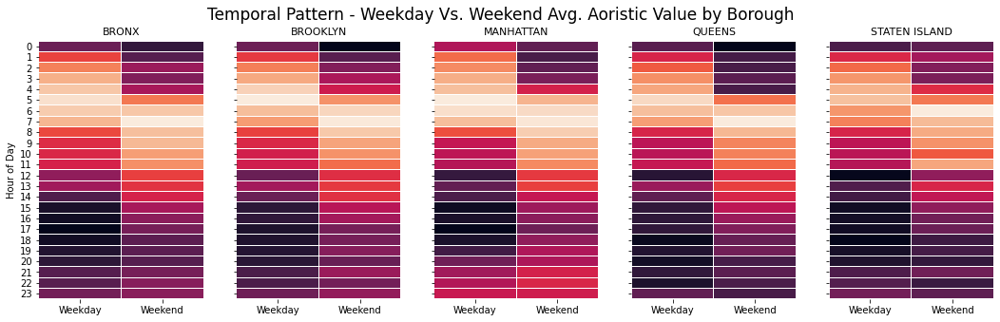

In [73]:
boro_list = list(df_hour_group_borough.BORO_NM.unique())

# plot heatmap on weekday and weekend difference by borough
fig,ax = plt.subplots(ncols=5,nrows=1,figsize=(18,5))

idx=0
for i in range(0,5):
    for j in range(0,1):
        boro = boro_list[idx]
        if idx < len(boro_list)-1:
            idx=idx+1
        data = df_hour_group_borough.loc[df_hour_group_borough.BORO_NM == boro,['Weekday','Weekend']].reset_index(drop=True)
        sns.heatmap(data,linewidths=.05,cmap=colormap,cbar=False,ax=ax[i])
        ax[i].set_title(boro, fontsize=11)
        if i==0:
            ax[i].set_ylabel('Hour of Day')
        else:
            ax[i].set_yticklabels('')
plt.suptitle('Temporal Pattern - Weekday Vs. Weekend Avg. Aoristic Value by Borough',fontsize=17)
plt.show()

fig.savefig('Fig\WeekendWeekday_byBorough.jpg')

### Spatial Pattern

In [74]:
# Spatial point map (simple and not good at identifying shape, size, and scale of hotspot pattern) - for large data, its' very very time consuming

df_spatial = df.loc[(df.Latitude.notnull()) & (df.Longitude.notnull()) & (df.CMPLNT_FR_DT.dt.year.isin([2019,2020])),:]
df_spatial = df_spatial[df_spatial.Offense_Category.isin(offense_list)]
df_spatial.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 196314 entries, 2 to 707088
Data columns (total 29 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   CMPLNT_NUM                196314 non-null  int64         
 1   BORO_NM                   196314 non-null  object        
 2   CMPLNT_FR_DT              196314 non-null  datetime64[ns]
 3   CMPLNT_FR_TM              196314 non-null  datetime64[ns]
 4   CMPLNT_TO_DT              178253 non-null  datetime64[ns]
 5   CMPLNT_TO_TM              178253 non-null  datetime64[ns]
 6   CRM_ATPT_CPTD_CD          196314 non-null  object        
 7   OFNS_DESC                 196314 non-null  object        
 8   PREM_TYP_DESC             195061 non-null  object        
 9   RPT_DT                    196314 non-null  datetime64[ns]
 10  VIC_AGE_GROUP             196314 non-null  object        
 11  VIC_RACE                  196314 non-null  object        
 12  VI

In [75]:
# Aggregate the total count in each point in past 2 years
data=df_spatial.groupby(['Latitude', 'Longitude'])['CMPLNT_NUM'].count().reset_index().rename(columns={'CMPLNT_NUM':'Count'})
data_list = data.values.tolist()
data_list[0:5]

[[40.499947543000076, -74.23800586399994, 1.0],
 [40.50062851400003, -74.23655561999993, 1.0],
 [40.50091792200004, -74.24125266599998, 2.0],
 [40.50110098000005, -74.24034719999997, 1.0],
 [40.50146433200007, -74.238536244, 4.0]]

In [76]:
data.Count.describe()

count    53478.000000
mean         3.670930
std          6.532945
min          1.000000
25%          1.000000
50%          2.000000
75%          4.000000
max        479.000000
Name: Count, dtype: float64

In [77]:
# Plot density heat map
xmm=(data.Longitude.min()+data.Longitude.max())/2
ymm=(data.Latitude.min()+data.Latitude.max())/2

max_val=np.percentile(data.Count,75)
hmap = fm.Map(location=[ymm,xmm], zoom_start=10.4,tiles='cartodbpositron',crs='EPSG3857', width='90%', height='90%')
hm_wide = HeatMap(data_list, 
                  min_opacity=0.5,
                  #radius=5,
                  radius=6,
                  blur=9,
                  max_val=max_val                
                  , gradient={.45:'green',.6: 'blue', .75: 'orange', 0.9: 'red',0.95:'black'}
                 )
hmap.add_child(hm_wide)

In [78]:
## Define Spatial Formula
def great_circle(lat1, long1, lat2, long2):

    # Convert latitude and longitude to 
    # spherical coordinates in radians.
    degrees_to_radians = math.pi/180.0
        
    # phi = 90 - latitude
    phi1 = (90.0 - lat1)*degrees_to_radians
    phi2 = (90.0 - lat2)*degrees_to_radians
        
    # theta = longitude
    theta1 = long1*degrees_to_radians
    theta2 = long2*degrees_to_radians
    
    cos = (math.sin(phi1)*math.sin(phi2)*math.cos(theta1 - theta2) + 
           math.cos(phi1)*math.cos(phi2))
    
    if (cos > 1.0):
        cos = 1.0

    arc = math.acos( cos )

    # Remember to multiply arc by the radius of the earth 
    # in your favorite set of units to get length.
    return arc

def SpaceDistance(x,y):
    try:
        gc_dist = great_circle(x[1],x[0],y[1],y[0])
    except ValueError:
        gc_dist = np.Infinity
    
    if (gc_dist>spatial_dist_max):
        return np.Infinity
    else:
        return gc_dist
    #return great_circle(x[1],x[0],y[1],y[0])

In [79]:
data_agg = df_spatial[['Longitude','Latitude','BORO_NM']]
data_agg.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 196314 entries, 2 to 707088
Data columns (total 3 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Longitude  196314 non-null  float64
 1   Latitude   196314 non-null  float64
 2   BORO_NM    196314 non-null  object 
dtypes: float64(2), object(1)
memory usage: 6.0+ MB


In [80]:
# Perform Density based clustering (OPTIC due to large dataset) by spatial formula on Manhattan data
data_agg_MAH = data_agg.loc[data_agg.BORO_NM =='MANHATTAN',['Longitude','Latitude']]

kms_per_radian = 6371.0088
spatial_dist_max= 1 / kms_per_radian
n_neighbours = 50
clust_id_col_name='ClusterN'+str(n_neighbours)+'_s'+str(spatial_dist_max*kms_per_radian)

In [81]:
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
clustered_ST = OPTICS(metric=SpaceDistance, 
                      min_samples=n_neighbours)

clustered_ST = clustered_ST.fit(data_agg_MAH)

print("Clustering finished!")

labels=clustered_ST.labels_

unique_labels=np.unique(clustered_ST.labels_)
print('Result: {} records in the noise, labelled as -1, and {} clusters labelled as 0..{}'.
      format(data_agg_MAH[labels==-1].shape[0], len(unique_labels)-1, len(unique_labels)-2))
#clustered

data_agg_MAH[clust_id_col_name]=labels


# Getting cluster sizes
cluster_sizes = data_agg_MAH[clust_id_col_name].value_counts().rename_axis('Cluster id').to_frame('count')
print("Cluster sizes:")
print(cluster_sizes.head(15))
print("...")
print(cluster_sizes.tail(15))

cluster_sizes = cluster_sizes[cluster_sizes.index != -1] # no noise

max_cluster_size=cluster_sizes['count'].max()
print("max = ",max_cluster_size)

Clustering finished!
Result: 30654 records in the noise, labelled as -1, and 238 clusters labelled as 0..237
Cluster sizes:
            count
Cluster id       
-1          30654
 122          479
 76           275
 89           257
 85           247
 117          225
 179          224
 80           206
 40           197
 102          175
 209          173
 93           169
 184          168
 236          167
 223          157
...
            count
Cluster id       
214            51
57             51
194            51
163            51
70             51
164            51
211            50
188            50
52             50
148            50
62             50
227            50
38             50
88             50
26             50
max =  479


C:\Users\Hillie\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:804: RuntimeWarning: divide by zero encountered in true_divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]


In [82]:
data_agg_MAH.describe()

,Longitude,Latitude,ClusterN50_s1.0
count,51425.000000,51425.000000,51425.000000
mean,-73.971444,40.770306,47.817093
std,0.024150,0.039923,73.042864
min,-74.022463,40.638668,-1.000000
25%,-73.990544,40.739161,-1.000000
50%,-73.977431,40.761922,-1.000000
75%,-73.949189,40.799665,92.000000
max,-73.870063,40.883120,237.000000


In [83]:
# Plot the cluster in map

## Assign Color
color_list = ['#543005','#8c510a','#bf812d','#dfc27d','#f6e8c3','#c7eae5','#80cdc1','#35978f','#01665e','#003c30','#8e0152','#c51b7d','#de77ae','#f1b6da','#fde0ef','#e6f5d0','#b8e186','#7fbc41','#4d9221','#276419','#a50026','#d73027','#f46d43','#fdae61','#fee090','#e0f3f8','#abd9e9','#74add1','#4575b4','#313695','#9e0142','#d53e4f','#f46d43','#fdae61','#fee08b','#e6f598','#abdda4','#66c2a5','#3288bd','#5e4fa2','#8dd3c7','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69','#fccde5','#d9d9d9','#bc80bd','#ccebc5','#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6','#6a3d9a','#ffff99']
color_list = list(dict.fromkeys(color_list))

## only show top 50 clusters
data=data_agg_MAH[data_agg_MAH[clust_id_col_name] != -1].rename(columns={'Count_y':'Count'})
topcluster = list(data[clust_id_col_name].value_counts().index[0:len(color_list)])
data_list = data[['Latitude','Longitude']].values.tolist()

## Set map scale by max/min coordinates
xmm=(data.Longitude.min()+data.Longitude.max())/2
ymm=(data.Latitude.min()+data.Latitude.max())/2

## Set up base map
hmap = fm.Map(location=[ymm,xmm], zoom_start=11.3,tiles='cartodbpositron',crs='EPSG3857',  width='100%', height='100%')

## Assign the circle spots seperately
for id, row in data.iterrows():
    cluster_id = row[clust_id_col_name].astype('int64')
    if (cluster_id == (topcluster)).any():
        c = color_list[topcluster.index(cluster_id)]
        fm.CircleMarker((row['Latitude'], row['Longitude']), radius=0.1               
                        , color=c
                        ,size = 1
                        ,fill=True
                        , popup='Cluster: {}'.format(cluster_id)).add_to(hmap) 
            
hmap

### Grid Thematic Mapping

In [150]:
# Set up cell size (Square)
lon_range = (df_spatial.Longitude.min(), df_spatial.Longitude.max())
lon_cells = 75

print(lon_range)

lat_range = (df_spatial.Latitude.min(), df_spatial.Latitude.max())
lat_cells = 75

print(lat_range)

(-74.25437700099997, -73.70072029399995)
(40.499947543000076, 40.91272339600005)


In [151]:
lon_incr = (lon_range[1] - lon_range[0]) / lon_cells
lat_incr = (lat_range[1] - lat_range[0]) / lat_cells
x0, y0 = lon_range[0], lat_range[0]

cell_ids = []
grid_cells = []
for c in range(lon_cells):
    x1 = x0 + lon_incr
    for r in range(lat_cells):
        y1 = y0 + lat_incr
        grid_cells.append(Polygon([(x0,y0),(x0,y1),(x1,y1),(x1,y0)]))
        cell_ids.append('{:02d}_{:02d}'.format(c, r))
        y0 = y1
    x0 = x1
    y0 = lat_range[0]


In [152]:
# Assign cell id according to their latitude and longitude
df_spatial['grid_x']   = np.floor((df_spatial['Longitude'] - lon_range[0]) / (lon_range[1] - lon_range[0]) * lon_cells).astype(int)
df_spatial['grid_y']   = np.floor((df_spatial['Latitude']  - lat_range[0]) / (lat_range[1] - lat_range[0]) * lat_cells).astype(int)
# The cell_id column will be used to link our aggregate data to the grid GeoJSON object for plotting
df_spatial['cell_id']  = df_spatial[['grid_x','grid_y']].apply(lambda x: '{:02d}_{:02d}'.format(x.grid_x, x.grid_y), axis=1)

In [153]:
# SHow results
df_spatial.cell_id.value_counts()

35_45    1227
35_46     978
36_46     866
36_45     807
48_65     806
         ... 
61_66       1
50_49       1
45_71       1
04_03       1
54_53       1
Name: cell_id, Length: 1941, dtype: int64

In [154]:
# Show dataset
df_spatial.reset_index(inplace=True,drop=True)
df_spatial.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Mon,Tue,Wed,Thu,Fri,Sat,Sun,grid_x,grid_y,cell_id
0,100001361,QUEENS,2020-02-21,1900-01-01 12:00:00,2020-02-21,1900-01-01 12:01:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2020-08-11,...,0.0,0.0,0.0,0.0,1.000000,0.000000,0.0,49,43,49_43
1,100010196,BRONX,2020-05-29,1900-01-01 19:00:00,2020-05-30,1900-01-01 10:00:00,COMPLETED,GRAND LARCENY,STREET,2020-05-30,...,0.0,0.0,0.0,0.0,0.333333,0.666667,0.0,57,60,57_60
2,100013140,BROOKLYN,2020-05-29,1900-01-01 14:25:00,2020-05-29,1900-01-01 19:40:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2020-05-29,...,0.0,0.0,0.0,0.0,1.000000,0.000000,0.0,40,39,40_39
3,100017074,BROOKLYN,2019-05-05,1900-01-01 03:00:00,2019-05-05,1900-01-01 03:15:00,COMPLETED,RAPE,RESIDENCE - APT. HOUSE,2019-05-05,...,0.0,0.0,0.0,0.0,0.000000,0.000000,1.0,31,25,31_25
4,100019576,STATEN ISLAND,2019-05-16,1900-01-01 13:40:00,2019-05-16,1900-01-01 13:45:00,COMPLETED,DANGEROUS WEAPONS,RESIDENCE-HOUSE,2019-05-16,...,0.0,0.0,0.0,1.0,0.000000,0.000000,0.0,12,22,12_22


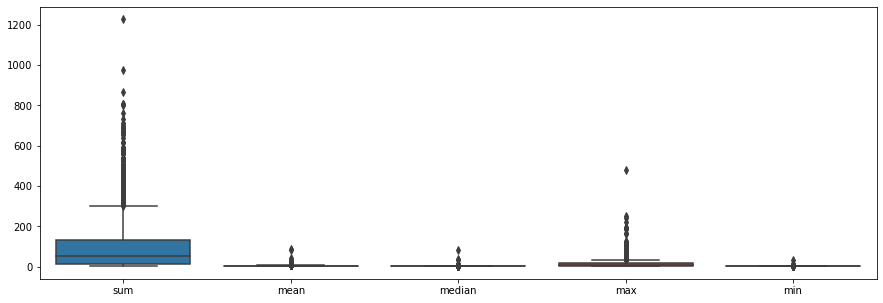

In [155]:
# Choose aggregation method with largest range of values
df_agg = df_spatial.groupby(['Longitude','Latitude','cell_id'])['CMPLNT_NUM'].count().reset_index().rename(columns={'CMPLNT_NUM':'Count'})
df_cell = df_agg.groupby(['cell_id'])['Count'].agg(['sum','mean','median','max','min']).reset_index()

d=df_cell.drop(columns='cell_id')
sns.boxplot(data=d)

# Summing up all counts 

In [156]:
# Plot the grid map

stat_compare = 'sum'
data = df_cell[['cell_id',stat_compare]]

## Color
cb2_ordrd_rgb = [(255,237,160),(254,217,118),(254,178,76),(253,141,60),(252,78,42),(227,26,28),(189,0,38),(128,0,38),(103,0,13)]


## Set up the base map
m = fm.Map(tiles='cartodbpositron', width='100%', height='100%') # If you adjusted the notebook display width to be as wide as your screen, the map might get very big. Adjust size as desired.
m.fit_bounds([[lat_range[0], lon_range[0]], [lat_range[1], lon_range[1]]])

lon_incr = (lon_range[1] - lon_range[0]) / lon_cells
lat_incr = (lat_range[1] - lat_range[0]) / lat_cells

min_val = data[stat_compare].min()
max_val = data[stat_compare].max()

ncol = len(cb2_ordrd_rgb)
col_range = 1 / (ncol-1)

for c in range(lon_cells):
    for h in range(lat_cells):
        cell_id = '{:02d}_{:02d}'.format(c,h)
        
        if (data.cell_id == cell_id).any():
            val = data.loc[data.cell_id == cell_id,stat_compare].reset_index(drop=True)[0]
        else:
            val = 0
        nval = (val - min_val) / (max_val - min_val)
        col_int = divmod(nval, col_range)
        ci = int(col_int[0])
        r = col_int[1] / col_range
        if (r > 0.0 and ci < ncol):
            c0 = cb2_ordrd_rgb[ci]
            c1 = cb2_ordrd_rgb[ci+1]
            col = (
                int((1.0-r)*c0[0] + r*c1[0]),
                int((1.0-r)*c0[1] + r*c1[1]),
                int((1.0-r)*c0[2] + r*c1[2])
            )
            c_string = '#{:02x}{:02x}{:02x}'.format(col[0], col[1], col[2])
        
        if (val > 0):
            fm.Rectangle(bounds = [(lat_range[0]+h*lat_incr, lon_range[0]+ c*lon_incr),(lat_range[0]+(h + 1)*lat_incr, lon_range[0]+ (c + 1)*lon_incr)]
                      #, radius=500
                      , color=c_string, fill_color=c_string, fill=True, weight=0, fill_opacity=0.6+(nval*0.5), popup=stat_compare+ ': {}'.format(val)).add_to(m)
            
title_html = '''
             <h4 align="center" style="font-size:12px"><b>{}</b></h3>
             '''.format('All Felony Crimes in NYC (2019-20)')
m.get_root().html.add_child(fm.Element(title_html))
m.save('map/map_{}.html'.format('Overall'))

m

## Grid Thematic Mapping by Offense

To observe how crime activities associated with space, grid mappings are performed by offense. 

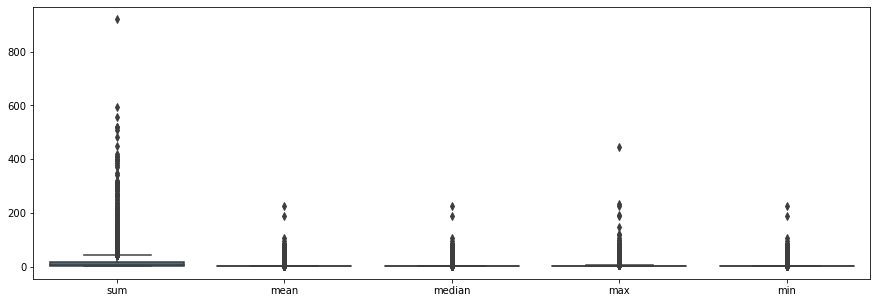

In [91]:
# Create dataset aggregating Total count in each grid cell by offense c
df_agg = df_spatial.groupby(['Longitude','Latitude','cell_id','Offense_Category'])['CMPLNT_NUM'].count().reset_index().rename(columns={'CMPLNT_NUM':'Count'})
df_cell = df_agg.groupby(['cell_id','Offense_Category'])['Count'].agg(['sum','mean','median','max','min']).reset_index()

## Show the variation within each aggregating method
d=df_cell.drop(columns='cell_id')
sns.boxplot(data=d)

In [92]:
# Show offense list
offense_list

['GRAND LARCENY & LARCENY OF MOTOR VEHICLE',
 'BURGLARY',
 'RAPE & SEX CRIMES',
 'DANGEROUS WEAPONS',
 'CRIMINAL MISCHIEF & RELATED OF',
 'FELONY ASSAULT',
 'ROBBERY',
 'THEFT-FRAUD',
 'ARSON',
 'MURDER & NON-NEGL. MANSLAUGHTER']

In [93]:
# Generate grid cell map for each offense

stat_compare = 'sum' # Determine aggregation method
lon_incr = (lon_range[1] - lon_range[0]) / lon_cells
lat_incr = (lat_range[1] - lat_range[0]) / lat_cells

## Assign color
cb2_ordrd_rgb = [(255,237,160),(254,217,118),(254,178,76),(253,141,60),(252,78,42),(227,26,28),(189,0,38),(128,0,38),(103,0,13)]
ncol = len(cb2_ordrd_rgb)
col_range = 1 / (ncol-1)


## Save the grid thematic mapping of each offense to 'Map-folder' with html link
for crime in offense_list: 
    data = df_cell.loc[df_cell.Offense_Category == crime,['cell_id',stat_compare]]


    # Set up the base map
    m = fm.Map(tiles='cartodbpositron', width='100%', height='100%') # If you adjusted the notebook display width to be as wide as your screen, the map might get very big. Adjust size as desired.
    m.fit_bounds([[lat_range[0], lon_range[0]], [lat_range[1], lon_range[1]]])

    min_val = data[stat_compare].min()
    max_val = data[stat_compare].max()

    for c in range(lon_cells):
        for h in range(lat_cells):
            cell_id = '{:02d}_{:02d}'.format(c,h)

            if (data.cell_id == cell_id).any():
                val = data.loc[data.cell_id == cell_id,stat_compare].reset_index(drop=True)[0]
            else:
                val = 0
            nval = (val - min_val) / (max_val - min_val)

       # Determine interpolated color
            col_int = divmod(nval, col_range)
            ci = int(col_int[0])
            r = col_int[1] / col_range
            if (r > 0.0 and ci < ncol):
                c0 = cb2_ordrd_rgb[ci]
                c1 = cb2_ordrd_rgb[ci+1]
                col = (
                    int((1.0-r)*c0[0] + r*c1[0]),
                    int((1.0-r)*c0[1] + r*c1[1]),
                    int((1.0-r)*c0[2] + r*c1[2])
                )
                c_string = '#{:02x}{:02x}{:02x}'.format(col[0], col[1], col[2])

            if (val >= 0):
                fm.Rectangle(bounds = [(lat_range[0]+h*lat_incr, lon_range[0]+ c*lon_incr),(lat_range[0]+(h + 1)*lat_incr, lon_range[0]+ (c + 1)*lon_incr)]
                          #, radius=500
                          , color=c_string, fill_color=c_string, fill=True, weight=0, fill_opacity=0.6+(nval*0.5), popup=stat_compare+ ': {}'.format(val)).add_to(m)
    title_html = '''
             <h4 align="center" style="font-size:12px"><b>{}</b></h3>
             '''.format('Offense = ' + crime)
    m.get_root().html.add_child(fm.Element(title_html))
    print(crime)
    m.save('map/map_{}.html'.format(crime))
    

GRAND LARCENY & LARCENY OF MOTOR VEHICLE
BURGLARY
RAPE & SEX CRIMES
DANGEROUS WEAPONS
CRIMINAL MISCHIEF & RELATED OF
FELONY ASSAULT
ROBBERY
THEFT-FRAUD
ARSON
MURDER & NON-NEGL. MANSLAUGHTER


#### Summary
It is discovered that most Manhattan hotpots, especially Lower Manhattan, are contributed by possession of others’ belongings such as Burglary, Theft, Larceny and Robbery. These crimes are mostly committed in Manhattan. On the other hand, crimes causing human death/ casualties, including Assault, Murder, Arson and Dangerous Weapons, are found mostly in Upper Manhattan and Brooklyn. This may be attributed to social issues such as homeless and poverty in two regions. Besides, no spatial pattern is found amongst Sex Crime.

## Spatial Temporal Pattern in Past 5 years (2015-2020)

In [98]:
# Create data containing coordinate information of past 5 years
df_spatial_5yr = df.loc[(df.Latitude.notnull()) & (df.Longitude.notnull()),:]
df_spatial_5yr = df_spatial_5yr[df_spatial_5yr.Offense_Category.isin(offense_list)].reset_index(drop=True)
# df_spatial_5yr.drop(columns='Unnamed: 0',inplace=True)

# Generate attribute containing the 'Year' information, and take time as distance for clustering
df_spatial_5yr['year'] = df_spatial_5yr.CMPLNT_FR_DT.dt.year
df_spatial_5yr['TimeDist'] = (df_spatial_5yr.CMPLNT_FR  - datetime.datetime(2015,10,1,0,0,0)).dt.total_seconds()/60/60/24 # tiime distance by days

# Show results
df_spatial_5yr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 587654 entries, 0 to 587653
Data columns (total 31 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   CMPLNT_NUM                587654 non-null  int64         
 1   BORO_NM                   587653 non-null  object        
 2   CMPLNT_FR_DT              587654 non-null  datetime64[ns]
 3   CMPLNT_FR_TM              587654 non-null  datetime64[ns]
 4   CMPLNT_TO_DT              518287 non-null  datetime64[ns]
 5   CMPLNT_TO_TM              518287 non-null  datetime64[ns]
 6   CRM_ATPT_CPTD_CD          587654 non-null  object        
 7   OFNS_DESC                 587654 non-null  object        
 8   PREM_TYP_DESC             583906 non-null  object        
 9   RPT_DT                    587654 non-null  datetime64[ns]
 10  VIC_AGE_GROUP             587654 non-null  object        
 11  VIC_RACE                  587654 non-null  object        
 12  VI

In [99]:
# Show results
df_spatial_5yr.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,year,TimeDist
0,100000065,MANHATTAN,2018-09-22,1900-01-01 23:35:00,NaT,NaT,COMPLETED,GRAND LARCENY OF MOTOR VEHICLE,STREET,2018-09-23,...,NaN,0.000000,0.000000,0.000000,0.000000,0.0,1.0,0.0,2018,1087.982639
1,100001077,QUEENS,2016-09-13,1900-01-01 09:50:00,NaT,NaT,COMPLETED,GRAND LARCENY,NaN,2016-09-13,...,NaN,0.000000,1.000000,0.000000,0.000000,0.0,0.0,0.0,2016,348.409722
2,100001361,QUEENS,2020-02-21,1900-01-01 12:00:00,2020-02-21,1900-01-01 12:01:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2020-08-11,...,1.0,0.000000,0.000000,0.000000,0.000000,1.0,0.0,0.0,2020,1604.500000
3,100006447,BROOKLYN,2018-03-20,1900-01-01 18:30:00,2018-03-22,1900-01-01 07:40:00,COMPLETED,BURGLARY,STREET,2018-03-22,...,2230.0,0.000000,0.147982,0.645740,0.206278,0.0,0.0,0.0,2018,901.770833
4,100008331,BROOKLYN,2018-08-20,1900-01-01 20:30:00,2018-08-23,1900-01-01 10:30:00,COMPLETED,GRAND LARCENY OF MOTOR VEHICLE,STREET,2018-09-24,...,3720.0,0.056452,0.387097,0.387097,0.169355,0.0,0.0,0.0,2018,1054.854167


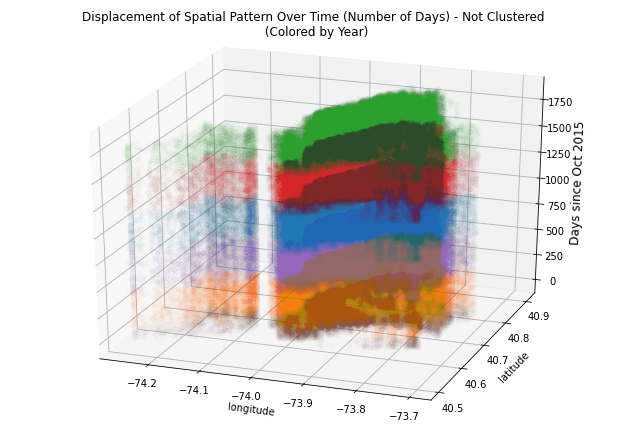

In [109]:
# Generate 3-D plot showeing all plots in past 5 years (without clustering)

from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(1, figsize=(9, 6))

ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=25, azim=-70) # change parameters here for looking from a different perspective


years=df_spatial_5yr['year'].unique()
    
for year in years :
    this_year = df_spatial_5yr[df_spatial_5yr['year']==year].reset_index(drop=True)
    ax.scatter(this_year['Longitude'], this_year['Latitude'], this_year['TimeDist'], alpha=0.01,label=year)
    
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
ax.set_zlabel('Days since Oct 2015', fontsize=12, rotation = 90)

plt.title('Displacement of Spatial Pattern Over Time (Number of Days) - Not Clustered \n (Colored by Year)')
plt.show()



In [111]:
print('Total number of crime in past 5 years is {}'.format(df_spatial_5yr.shape[0]))

# Show number of crime by year and by borough
df_spatial_5yr.groupby(['BORO_NM','year'])['year'].count()

Total number of crime in past 5 years is 587654


BORO_NM        year
BRONX          2015     6569
               2016    25301
               2017    23936
               2018    22875
               2019    22959
               2020    17071
BROOKLYN       2015    10130
               2016    36643
               2017    35090
               2018    34693
               2019    34087
               2020    24109
MANHATTAN      2015     8479
               2016    31542
               2017    30808
               2018    31379
               2019    31185
               2020    20240
QUEENS         2015     7027
               2016    26296
               2017    24244
               2018    23615
               2019    23452
               2020    17568
STATEN ISLAND  2015     1060
               2016     4159
               2017     3748
               2018     3745
               2019     3308
               2020     2335
Name: year, dtype: int64

Previous findings suggest Manhattan has dense hotspots, to reduce computational burden, only Manhattan is reviewed in this notebook. Parameter could be change.

In [112]:
Review_borough = 'MANHATTAN' # Update if necessary
df_spatial_5yr_MAH = df_spatial_5yr[df_spatial_5yr.BORO_NM==Review_borough]

# Review the number of case in chosen borough by year
df_spatial_5yr_MAH.year.value_counts()

2016    31542
2018    31379
2019    31185
2017    30808
2020    20240
2015     8479
Name: year, dtype: int64

In [113]:
# Clustering are performed by year to reduce computational burden, 2016 is taken as example to determine appropriate parameters for density-based clustering
chosen_year = 2016
df_spatial_2016_MAH = df_spatial_5yr_MAH[df_spatial_5yr_MAH.year == chosen_year].reset_index()

df_spatial_2016_MAH.head()

,index,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,...,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,year,TimeDist
0,31,100040203,MANHATTAN,2016-07-21,1900-01-01 14:32:00,2016-07-21,1900-01-01 14:42:00,COMPLETED,GRAND LARCENY,BANK,...,10.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2016,294.605556
1,33,100042004,MANHATTAN,2016-07-06,1900-01-01 08:00:00,2016-07-06,1900-01-01 19:45:00,COMPLETED,GRAND LARCENY,CLOTHING/BOUTIQUE,...,705.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2016,279.333333
2,45,100063821,MANHATTAN,2016-04-21,1900-01-01 15:40:00,2016-04-21,1900-01-01 15:45:00,COMPLETED,BURGLARY,RESIDENCE - APT. HOUSE,...,5.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2016,203.652778
3,51,100072204,MANHATTAN,2016-01-04,1900-01-01 00:01:00,2016-01-05,1900-01-01 23:59:00,COMPLETED,GRAND LARCENY,RESIDENCE-HOUSE,...,2878.0,0.5,0.5,0.0,0.0,0.0,0.0,0.0,2016,95.000694
4,62,100091825,MANHATTAN,2016-04-15,1900-01-01 04:30:00,2016-04-15,1900-01-01 04:45:00,COMPLETED,BURGLARY,CONSTRUCTION SITE,...,15.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2016,197.187500


In [114]:
# Design algorithm for space-time clustering

def SpaceTimeDistance(x,y):
    #print('Params = {},{}'.format(spatial_dist_max,temporal_dist_max))
    diff_days = math.fabs(x[2] - y[2])
    if (np.isnan(diff_days) or diff_days > temporal_dist_max):
        return np.Infinity
    
    try:
        gc_dist = great_circle(x[1],x[0],y[1],y[0])
    except ValueError:
        #print(x[1],x[0],y[1],y[0])
        gc_dist = np.Infinity
    
    if (gc_dist>spatial_dist_max):
        return np.Infinity
    
    noraml_t = (diff_days-0)/(temporal_dist_max-0)
    normal_s = (gc_dist-0)/(spatial_dist_max-0)
    
    # Adjust weighting of space and time in clustering
    weight_s = 0.5
    weight_t = 0.5
    
    # Apply SNN clustering
    if (weight_s + weight_t == 1):
        return (weight_s*normal_s + noraml_t*weight_t)* spatial_dist_max
    
    # Apply another density-based algorithm: determine of largest distance among time and spatial distance
    #ratio_t=diff_days/temporal_dist_max
    #ratio_d=gc_dist/spatial_dist_max
    #if (ratio_d>ratio_t):
    #    return gc_dist
    #else:
    #    return ratio_t * spatial_dist_max

In [115]:
# Adjust and tune parameters for DB clustering
s= 0.1
spatial_dist_max = s / kms_per_radian
temporal_dist_max = 30
n_neighbours = 30

clust_id_col_name='Cluster_s'+str(s)+'_t'+str(temporal_dist_max)+'_n'+str(n_neighbours)

In [116]:
# Start clustering and check cluster values

data= df_spatial_2016_MAH[['Longitude','Latitude','TimeDist']].reset_index(drop=True)

clustered_ST = DBSCAN(metric=SpaceTimeDistance, 
                      min_samples=n_neighbours).fit(data)

print("Clustering finished!")

labels=clustered_ST.labels_

unique_labels=np.unique(clustered_ST.labels_)
df_spatial_2016_MAH[clust_id_col_name]=labels

print('Result: {} records in the noise, labelled as -1, and {} clusters labelled as 0..{}'.
      format(df_spatial_2016_MAH[labels==-1].shape[0], len(unique_labels)-1, len(unique_labels)-2))
#clustered



# Getting cluster sizes
cluster_sizes = df_spatial_2016_MAH[clust_id_col_name].value_counts().rename_axis('Cluster id').to_frame('count')
print("Cluster sizes:")
print(cluster_sizes.head(15))
print("...")
print(cluster_sizes.tail(15))

cluster_sizes = cluster_sizes[cluster_sizes.index != -1] # no noise

max_cluster_size=cluster_sizes['count'].max()
print("max = ",max_cluster_size)

Clustering finished!
Result: 30057 records in the noise, labelled as -1, and 25 clusters labelled as 0..24
Cluster sizes:
            count
Cluster id       
-1          30057
 0            363
 8             85
 2             75
 16            64
 5             59
 12            58
 9             54
 1             52
 11            52
 18            52
 6             49
 15            46
 13            44
 10            43
...
            count
Cluster id       
6              49
15             46
13             44
10             43
4              41
3              40
17             40
22             38
14             38
7              36
19             34
21             31
24             31
23             30
20             30
max =  363


In [117]:
# Generate cluster color palette (categorical palette)
color_list = ['#f7f4f9','#e7e1ef','#d4b9da','#c994c7','#df65b0','#e7298a','#ce1256','#980043','#67001f','#ffffd9','#edf8b1','#c7e9b4','#7fcdbb','#41b6c4','#1d91c0','#225ea8','#253494','#081d58','#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02','#a6761d','#b35806','#e08214','#fdb863','#fee0b6','#d8daeb','#b2abd2','#8073ac','#542788','#d73027','#f46d43','#fdae61','#fee090','#e0f3f8','#abd9e9','#74add1','#4575b4','#c51b7d','#de77ae','#f1b6da','#fde0ef','#e6f5d0','#b8e186','#7fbc41','#4d9221','#543005','#8c510a','#bf812d','#dfc27d','#f6e8c3','#c7eae5','#80cdc1','#35978f','#01665e','#003c30','#8e0152','#c51b7d','#de77ae','#f1b6da','#fde0ef','#e6f5d0','#b8e186','#7fbc41','#4d9221','#276419','#a50026','#d73027','#f46d43','#fdae61','#fee090','#e0f3f8','#abd9e9','#74add1','#4575b4','#313695','#9e0142','#d53e4f','#f46d43','#fdae61','#fee08b','#e6f598','#abdda4','#66c2a5','#3288bd','#5e4fa2','#8dd3c7','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69','#fccde5','#d9d9d9','#bc80bd','#ccebc5','#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6','#6a3d9a','#ffff99']
color_list = list(dict.fromkeys(color_list)) # Remove duplciate color
print('There are {} colors within the color palette'.format(len(color_list)))

for id,row in df_spatial_2016_MAH.iterrows():
    cluster_id = row[clust_id_col_name]
    if (cluster_id==-1):
        color='#000000'
    else:
        color=color_list[cluster_id % len(color_list)]
    df_spatial_2016_MAH.loc[id,'colors']=color

There are 91 colors within the color palette


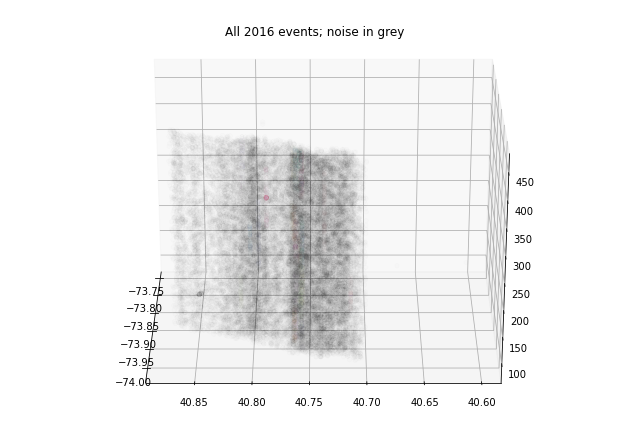

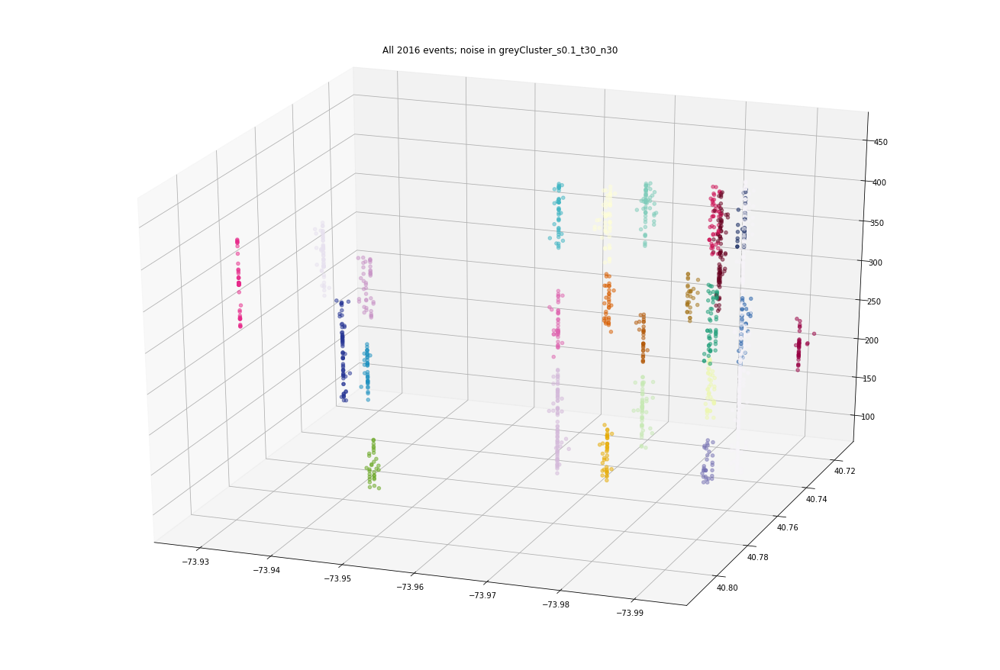

In [118]:
# Show 3-D plot for clustering results

# figure where noise is not removed
fig = plt.figure(1, figsize=(9, 6))
ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=25, azim=-180) # change parameters here for experimenting
ax.scatter(df_spatial_2016_MAH['Longitude'], df_spatial_2016_MAH['Latitude'], df_spatial_2016_MAH['TimeDist'], c=df_spatial_2016_MAH['colors'], alpha=0.007)
plt.title('All 2016 events; noise in grey')
plt.show()

# Figure where noise is removed
data = df_spatial_2016_MAH[df_spatial_2016_MAH[clust_id_col_name]!=-1]
fig = plt.figure(1, figsize=(9, 6))
ax = Axes3D(fig, rect=[0, 0, 2, 2], elev=25, azim=-250) # change parameters here for experimenting
ax.scatter(data['Longitude'], data['Latitude'], data['TimeDist'], c=data['colors'], alpha=0.5)
plt.title('All 2016 events; noise in grey' + clust_id_col_name )
plt.show()

In [119]:
# show different clustering attempts from tuning parameters
df_spatial_2016_MAH.info()

# Finalize the parameters before moving onto the next step

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31542 entries, 0 to 31541
Data columns (total 34 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   index                     31542 non-null  int64         
 1   CMPLNT_NUM                31542 non-null  int64         
 2   BORO_NM                   31542 non-null  object        
 3   CMPLNT_FR_DT              31542 non-null  datetime64[ns]
 4   CMPLNT_FR_TM              31542 non-null  datetime64[ns]
 5   CMPLNT_TO_DT              26823 non-null  datetime64[ns]
 6   CMPLNT_TO_TM              26823 non-null  datetime64[ns]
 7   CRM_ATPT_CPTD_CD          31542 non-null  object        
 8   OFNS_DESC                 31542 non-null  object        
 9   PREM_TYP_DESC             31296 non-null  object        
 10  RPT_DT                    31542 non-null  datetime64[ns]
 11  VIC_AGE_GROUP             31542 non-null  object        
 12  VIC_RACE          

In [120]:
# With reference to the finalized parameters, perform clustering for other years separately

# year 2017
## Create 2017 dataset on chosen city
df_spatial_2017_MAH = df_spatial_5yr_MAH[df_spatial_5yr_MAH.year == 2017].reset_index()

df_spatial_2017_MAH.head()

,index,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,...,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,year,TimeDist
0,28,100037063,MANHATTAN,2017-03-14,1900-01-01 17:00:00,2017-03-15,1900-01-01 13:00:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,...,1200.0,0.0,0.35,0.65,0.0,0.0,0.0,0.0,2017,530.708333
1,46,100064623,MANHATTAN,2017-10-21,1900-01-01 19:30:00,2017-10-21,1900-01-01 19:35:00,COMPLETED,GRAND LARCENY,RESTAURANT/DINER,...,5.0,0.0,0.00,0.00,0.0,0.0,1.0,0.0,2017,751.812500
2,104,100130641,MANHATTAN,2017-01-14,1900-01-01 11:45:00,2017-01-14,1900-01-01 12:15:00,COMPLETED,GRAND LARCENY,GYM/FITNESS FACILITY,...,30.0,0.0,0.00,0.00,0.0,0.0,1.0,0.0,2017,471.489583
3,107,100139003,MANHATTAN,2017-02-28,1900-01-01 16:33:00,2017-02-28,1900-01-01 16:40:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,...,7.0,0.0,1.00,0.00,0.0,0.0,0.0,0.0,2017,516.689583
4,120,100165499,MANHATTAN,2017-08-12,1900-01-01 12:42:00,2017-08-12,1900-01-01 18:00:00,COMPLETED,GRAND LARCENY,JEWELRY,...,318.0,0.0,0.00,0.00,0.0,0.0,1.0,0.0,2017,681.529167


In [121]:
# Perform clustering

data= df_spatial_2017_MAH[['Longitude','Latitude','TimeDist']].reset_index(drop=True)

clustered_ST = DBSCAN(metric=SpaceTimeDistance, 
                      min_samples=n_neighbours).fit(data)

print("Clustering finished!")

labels=clustered_ST.labels_

unique_labels=np.unique(clustered_ST.labels_)
df_spatial_2017_MAH[clust_id_col_name]=labels

print('Result: {} records in the noise, labelled as -1, and {} clusters labelled as 0..{}'.
      format(df_spatial_2017_MAH[labels==-1].shape[0], len(unique_labels)-1, len(unique_labels)-2))

# Getting cluster sizes
cluster_sizes = df_spatial_2017_MAH[clust_id_col_name].value_counts().rename_axis('Cluster id').to_frame('count')
print("Cluster sizes:")
print(cluster_sizes.head(15))
print("...")
print(cluster_sizes.tail(15))

cluster_sizes = cluster_sizes[cluster_sizes.index != -1] # no noise

max_cluster_size=cluster_sizes['count'].max()
print("max = ",max_cluster_size)

Clustering finished!
Result: 29073 records in the noise, labelled as -1, and 27 clusters labelled as 0..26
Cluster sizes:
            count
Cluster id       
-1          29073
 4            281
 6            112
 3             94
 1             83
 0             82
 8             81
 7             81
 11            71
 15            60
 2             58
 21            55
 5             53
 14            52
 19            51
...
            count
Cluster id       
14             52
19             51
13             51
9              48
12             46
18             46
10             42
20             42
16             41
23             40
17             36
25             35
24             34
26             30
22             30
max =  281


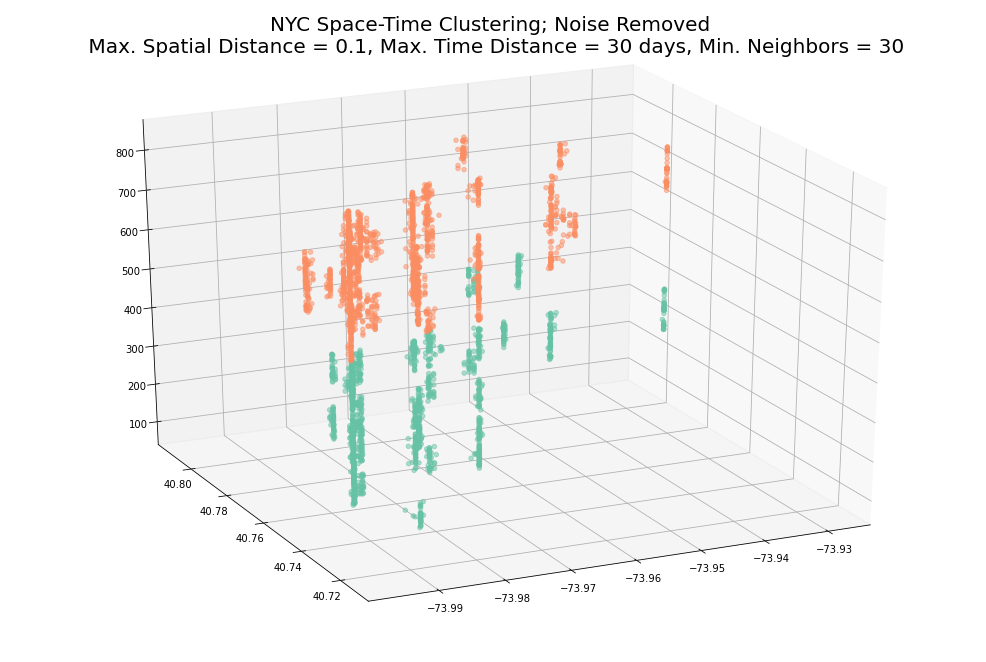

In [122]:
# Generate color palette for different years
color = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3','#a6d854']

# Generate 3-D plot containing two year's clusters (noise removed)
data = df_spatial_2016_MAH[df_spatial_2016_MAH[clust_id_col_name]!=-1]
data_2017 = df_spatial_2017_MAH[df_spatial_2017_MAH[clust_id_col_name]!=-1]
fig = plt.figure(1, figsize=(9, 6))
ax = Axes3D(fig, rect=[0, 0, 1.5, 1.5], elev=25, azim=-115) # change parameters here for experimenting
ax.scatter(data['Longitude'], data['Latitude'], data['TimeDist'], c=color[0], alpha=0.5)
ax.scatter(data_2017['Longitude'], data_2017['Latitude'], data_2017['TimeDist'], c=color[1], alpha=0.5)

plt.title('NYC Space-Time Clustering; Noise Removed \n Max. Spatial Distance = {}, Max. Time Distance = {} days, Min. Neighbors = {}'.format(s,temporal_dist_max,n_neighbours), fontsize = 20)
plt.show()

In [123]:
# Create dataset for 2018
df_spatial_2018_MAH = df_spatial_5yr_MAH[df_spatial_5yr_MAH.year == 2018].reset_index(drop=True)

df_spatial_2018_MAH.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,year,TimeDist
0,100000065,MANHATTAN,2018-09-22,1900-01-01 23:35:00,NaT,NaT,COMPLETED,GRAND LARCENY OF MOTOR VEHICLE,STREET,2018-09-23,...,NaN,0.0,0.000000,0.0,0.0,0.000000,1.0,0.0,2018,1087.982639
1,100011502,MANHATTAN,2018-10-02,1900-01-01 13:00:00,2018-10-02,1900-01-01 13:03:00,COMPLETED,GRAND LARCENY,CLOTHING/BOUTIQUE,2018-10-02,...,3.0,0.0,1.000000,0.0,0.0,0.000000,0.0,0.0,2018,1097.541667
2,100022486,MANHATTAN,2018-02-13,1900-01-01 16:45:00,2018-02-13,1900-01-01 17:15:00,COMPLETED,GRAND LARCENY,DRUG STORE,2018-02-13,...,30.0,0.0,1.000000,0.0,0.0,0.000000,0.0,0.0,2018,866.697917
3,100124859,MANHATTAN,2018-10-13,1900-01-01 19:29:00,2018-10-13,1900-01-01 19:50:00,COMPLETED,GRAND LARCENY,STREET,2018-10-13,...,21.0,0.0,0.000000,0.0,0.0,0.000000,1.0,0.0,2018,1108.811806
4,100188067,MANHATTAN,2018-06-08,1900-01-01 09:00:00,2018-09-25,1900-01-01 17:00:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2018-10-31,...,157440.0,0.0,0.006479,0.0,0.0,0.005716,0.0,0.0,2018,981.375000


In [124]:
# Perform clustering
data= df_spatial_2018_MAH[['Longitude','Latitude','TimeDist']].reset_index(drop=True)

clustered_ST = DBSCAN(metric=SpaceTimeDistance, 
                      min_samples=n_neighbours).fit(data)

print("Clustering finished!")

labels=clustered_ST.labels_

unique_labels=np.unique(clustered_ST.labels_)
df_spatial_2018_MAH[clust_id_col_name]=labels

print('Result: {} records in the noise, labelled as -1, and {} clusters labelled as 0..{}'.
      format(df_spatial_2018_MAH[labels==-1].shape[0], len(unique_labels)-1, len(unique_labels)-2))

# Getting cluster sizes
cluster_sizes = df_spatial_2018_MAH[clust_id_col_name].value_counts().rename_axis('Cluster id').to_frame('count')
print("Cluster sizes:")
print(cluster_sizes.head(15))
print("...")
print(cluster_sizes.tail(15))

cluster_sizes = cluster_sizes[cluster_sizes.index != -1] # no noise

max_cluster_size=cluster_sizes['count'].max()
print("max = ",max_cluster_size)

Clustering finished!
Result: 29529 records in the noise, labelled as -1, and 23 clusters labelled as 0..22
Cluster sizes:
            count
Cluster id       
-1          29529
 0            338
 3            265
 1            139
 7            118
 2             85
 9             82
 13            79
 6             74
 4             69
 8             68
 17            59
 10            53
 5             51
 12            49
...
            count
Cluster id       
4              69
8              68
17             59
10             53
5              51
12             49
20             49
11             44
18             40
22             38
15             34
19             33
14             30
16             30
21             23
max =  338


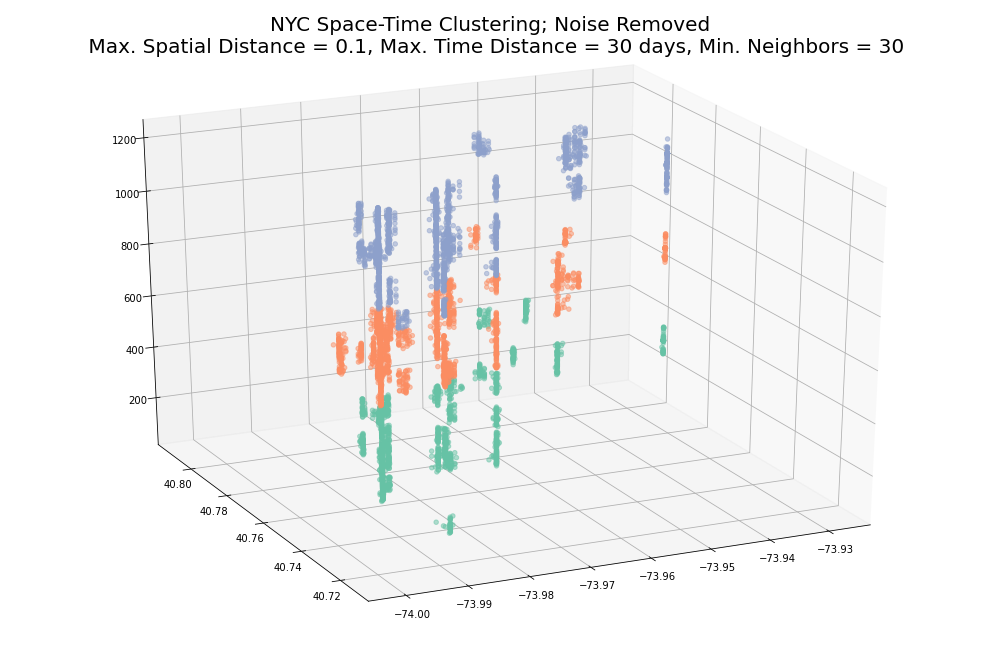

In [125]:
# Color palette 
color = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3','#a6d854']

# Plot 3-D graph on 3-years clustering (noised removed)
data = df_spatial_2016_MAH[df_spatial_2016_MAH[clust_id_col_name]!=-1]
data_2017 = df_spatial_2017_MAH[df_spatial_2017_MAH[clust_id_col_name]!=-1]
data_2018 = df_spatial_2018_MAH[df_spatial_2018_MAH[clust_id_col_name]!=-1]

fig = plt.figure(1, figsize=(9, 6))
ax = Axes3D(fig, rect=[0, 0, 1.5, 1.5], elev=25, azim=-115) # change parameters here for experimenting
ax.scatter(data['Longitude'], data['Latitude'], data['TimeDist'], c=color[0], alpha=0.5)
ax.scatter(data_2017['Longitude'], data_2017['Latitude'], data_2017['TimeDist'], c=color[1], alpha=0.5)
ax.scatter(data_2018['Longitude'], data_2018['Latitude'], data_2018['TimeDist'], c=color[2], alpha=0.5)
plt.title('NYC Space-Time Clustering; Noise Removed \n Max. Spatial Distance = {}, Max. Time Distance = {} days, Min. Neighbors = {}'.format(s,temporal_dist_max,n_neighbours), fontsize = 20)
plt.show()

In [126]:
# Create 2019 dataset
df_spatial_2019_MAH = df_spatial_5yr_MAH[df_spatial_5yr_MAH.year == 2019].reset_index(drop=True)

df_spatial_2019_MAH.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,year,TimeDist
0,100030509,MANHATTAN,2019-03-10,1900-01-01 01:10:00,2019-03-10,1900-01-01 03:00:00,COMPLETED,GRAND LARCENY,TRANSIT - NYC SUBWAY,2019-03-10,...,110.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1.0,2019,1256.048611
1,100055406,MANHATTAN,2019-03-30,1900-01-01 18:10:00,2019-03-30,1900-01-01 18:20:00,COMPLETED,GRAND LARCENY,DEPARTMENT STORE,2019-03-31,...,10.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.0,2019,1276.756944
2,100062733,MANHATTAN,2019-08-02,1900-01-01 23:00:00,2019-08-03,1900-01-01 10:00:00,COMPLETED,BURGLARY,NaN,2019-08-03,...,660.0,0.0,0.0,0.0,0.0,0.090909,0.909091,0.0,2019,1401.958333
3,100078829,MANHATTAN,2019-09-06,1900-01-01 09:00:00,2019-09-06,1900-01-01 09:10:00,COMPLETED,FELONY ASSAULT,RESIDENCE - APT. HOUSE,2019-09-06,...,10.0,0.0,0.0,0.0,0.0,1.000000,0.000000,0.0,2019,1436.375000
4,100094303,MANHATTAN,2019-07-29,1900-01-01 23:00:00,2019-07-29,1900-01-01 23:30:00,COMPLETED,GRAND LARCENY,PARK/PLAYGROUND,2019-07-30,...,30.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.0,2019,1397.958333


In [127]:
# Perform clustering
data= df_spatial_2019_MAH[['Longitude','Latitude','TimeDist']].reset_index(drop=True)

clustered_ST = DBSCAN(metric=SpaceTimeDistance, 
                      min_samples=n_neighbours).fit(data)

print("Clustering finished!")

labels=clustered_ST.labels_

unique_labels=np.unique(clustered_ST.labels_)
df_spatial_2019_MAH[clust_id_col_name]=labels

print('Result: {} records in the noise, labelled as -1, and {} clusters labelled as 0..{}'.
      format(df_spatial_2019_MAH[labels==-1].shape[0], len(unique_labels)-1, len(unique_labels)-2))

# Getting cluster sizes
cluster_sizes = df_spatial_2019_MAH[clust_id_col_name].value_counts().rename_axis('Cluster id').to_frame('count')
print("Cluster sizes:")
print(cluster_sizes.head(15))
print("...")
print(cluster_sizes.tail(15))

cluster_sizes = cluster_sizes[cluster_sizes.index != -1] # no noise

max_cluster_size=cluster_sizes['count'].max()
print("max = ",max_cluster_size)

Clustering finished!
Result: 29566 records in the noise, labelled as -1, and 22 clusters labelled as 0..21
Cluster sizes:
            count
Cluster id       
-1          29566
 0            404
 11           114
 2             91
 12            85
 3             85
 4             78
 1             75
 20            64
 13            62
 19            59
 14            54
 18            49
 8             49
 9             48
...
            count
Cluster id       
20             64
13             62
19             59
14             54
18             49
8              49
9              48
5              46
7              44
16             41
17             40
6              35
15             34
10             31
21             31
max =  404


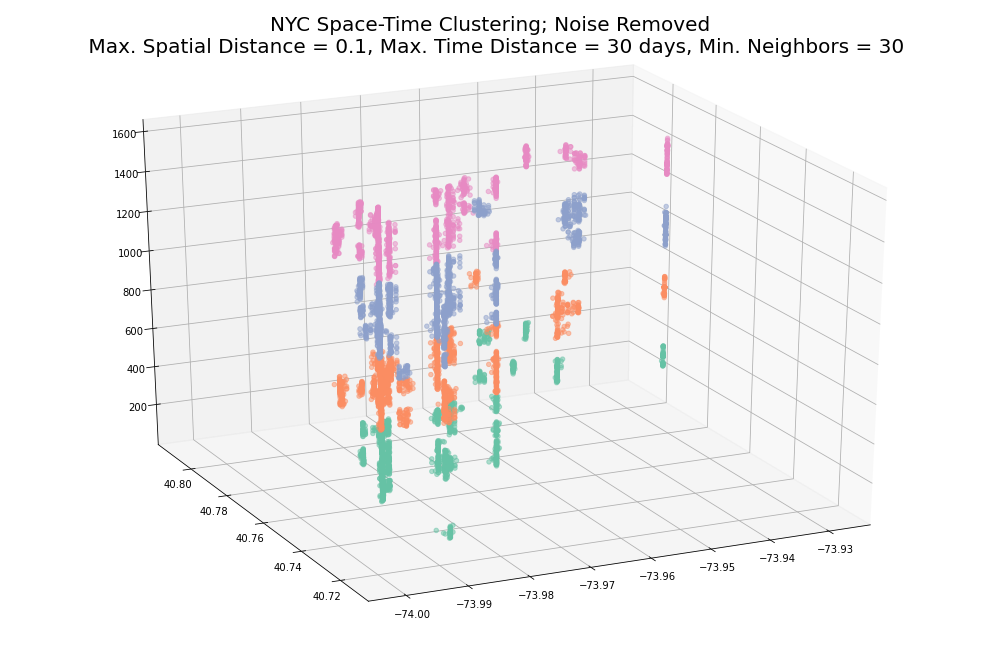

In [128]:
# Color palette
color = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3','#a6d854']

# Plot 3-D graph for 4 year clustering
data = df_spatial_2016_MAH[df_spatial_2016_MAH[clust_id_col_name]!=-1]
data_2017 = df_spatial_2017_MAH[df_spatial_2017_MAH[clust_id_col_name]!=-1]
data_2018 = df_spatial_2018_MAH[df_spatial_2018_MAH[clust_id_col_name]!=-1]
data_2019 = df_spatial_2019_MAH[df_spatial_2019_MAH[clust_id_col_name]!=-1]
fig = plt.figure(1, figsize=(9, 6))

ax = Axes3D(fig, rect=[0, 0, 1.5, 1.5], elev=25, azim=-115) # change parameters here for experimenting
ax.scatter(data['Longitude'], data['Latitude'], data['TimeDist'], c=color[0], alpha=0.5)
ax.scatter(data_2017['Longitude'], data_2017['Latitude'], data_2017['TimeDist'], c=color[1], alpha=0.5)
ax.scatter(data_2018['Longitude'], data_2018['Latitude'], data_2018['TimeDist'], c=color[2], alpha=0.5)
ax.scatter(data_2019['Longitude'], data_2019['Latitude'], data_2019['TimeDist'], c=color[3], alpha=0.5)
plt.title('NYC Space-Time Clustering; Noise Removed \n Max. Spatial Distance = {}, Max. Time Distance = {} days, Min. Neighbors = {}'.format(s,temporal_dist_max,n_neighbours), fontsize = 20)
plt.show()

In [129]:
# Create dataset for 2020
df_spatial_2020_MAH = df_spatial_5yr_MAH[df_spatial_5yr_MAH.year == 2020].reset_index(drop=True)

df_spatial_2020_MAH.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,year,TimeDist
0,100021385,MANHATTAN,2020-03-06,1900-01-01 18:30:00,2020-03-06,1900-01-01 19:00:00,COMPLETED,CRIMINAL MISCHIEF & RELATED OF,RESTAURANT/DINER,2020-03-06,...,30.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2020,1618.770833
1,100103271,MANHATTAN,2020-09-14,1900-01-01 17:54:00,2020-09-14,1900-01-01 17:56:00,COMPLETED,FELONY ASSAULT,STREET,2020-09-14,...,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2020,1810.745833
2,100104630,MANHATTAN,2020-07-25,1900-01-01 18:30:00,2020-07-25,1900-01-01 21:00:00,COMPLETED,GRAND LARCENY,RESTAURANT/DINER,2020-07-25,...,150.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020,1759.770833
3,100121951,MANHATTAN,2020-04-15,1900-01-01 20:27:00,NaT,NaT,COMPLETED,FELONY ASSAULT,OTHER,2020-04-15,...,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2020,1658.852083
4,100245991,MANHATTAN,2020-05-22,1900-01-01 08:00:00,2020-05-22,1900-01-01 11:30:00,COMPLETED,FELONY ASSAULT,RESIDENCE - APT. HOUSE,2020-05-22,...,210.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2020,1695.333333


In [130]:
# Perform clustering
data= df_spatial_2020_MAH[['Longitude','Latitude','TimeDist']].reset_index(drop=True)

clustered_ST = DBSCAN(metric=SpaceTimeDistance, 
                      min_samples=n_neighbours).fit(data)

print("Clustering finished!")

labels=clustered_ST.labels_

unique_labels=np.unique(clustered_ST.labels_)
df_spatial_2020_MAH[clust_id_col_name]=labels

print('Result: {} records in the noise, labelled as -1, and {} clusters labelled as 0..{}'.
      format(df_spatial_2020_MAH[labels==-1].shape[0], len(unique_labels)-1, len(unique_labels)-2))

# Getting cluster sizes
cluster_sizes = df_spatial_2020_MAH[clust_id_col_name].value_counts().rename_axis('Cluster id').to_frame('count')
print("Cluster sizes:")
print(cluster_sizes.head(15))
print("...")
print(cluster_sizes.tail(15))

cluster_sizes = cluster_sizes[cluster_sizes.index != -1] # no noise

max_cluster_size=cluster_sizes['count'].max()
print("max = ",max_cluster_size)

Clustering finished!
Result: 19730 records in the noise, labelled as -1, and 10 clusters labelled as 0..9
Cluster sizes:
            count
Cluster id       
-1          19730
 4             79
 0             73
 5             60
 3             53
 2             51
 1             47
 7             43
 8             37
 6             37
 9             30
...
            count
Cluster id       
-1          19730
 4             79
 0             73
 5             60
 3             53
 2             51
 1             47
 7             43
 8             37
 6             37
 9             30
max =  79


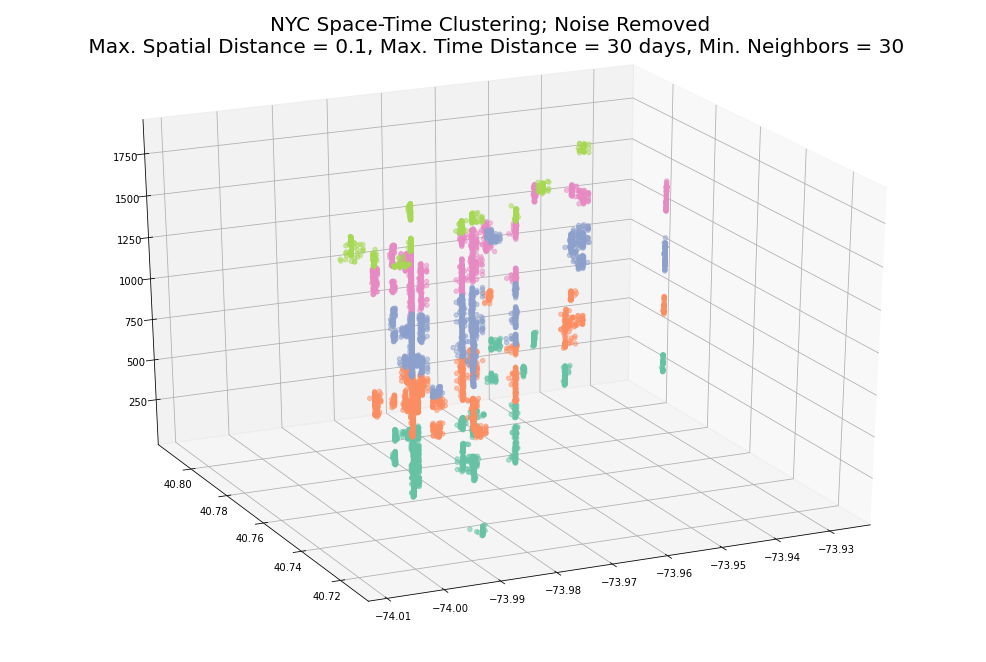

In [131]:
# Color-palette
color = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3','#a6d854']

# Plot 3-D graph for 2016-20 clusters (noise removed)
data = df_spatial_2016_MAH[df_spatial_2016_MAH[clust_id_col_name]!=-1]
data_2017 = df_spatial_2017_MAH[df_spatial_2017_MAH[clust_id_col_name]!=-1]
data_2018 = df_spatial_2018_MAH[df_spatial_2018_MAH[clust_id_col_name]!=-1]
data_2019 = df_spatial_2019_MAH[df_spatial_2019_MAH[clust_id_col_name]!=-1]
data_2020 = df_spatial_2020_MAH[df_spatial_2020_MAH[clust_id_col_name]!=-1]
fig = plt.figure(1, figsize=(9, 6))

ax = Axes3D(fig, rect=[0, 0, 1.5, 1.5], elev=25, azim=-115) # change parameters here for experimenting
ax.scatter(data['Longitude'], data['Latitude'], data['TimeDist'], c=color[0], alpha=0.5)
ax.scatter(data_2017['Longitude'], data_2017['Latitude'], data_2017['TimeDist'], c=color[1], alpha=0.5)
ax.scatter(data_2018['Longitude'], data_2018['Latitude'], data_2018['TimeDist'], c=color[2], alpha=0.5)
ax.scatter(data_2019['Longitude'], data_2019['Latitude'], data_2019['TimeDist'], c=color[3], alpha=0.5)
ax.scatter(data_2020['Longitude'], data_2020['Latitude'], data_2020['TimeDist'], c=color[4], alpha=0.5)
plt.title('NYC Space-Time Clustering; Noise Removed \n Max. Spatial Distance = {}, Max. Time Distance = {} days, Min. Neighbors = {}'.format(s,temporal_dist_max,n_neighbours), fontsize = 20)
plt.show()

In [132]:
# Create dataset for 2015 (Oct-Dec)
df_spatial_2015_MAH = df_spatial_5yr_MAH[df_spatial_5yr_MAH.year == 2015].reset_index(drop=True)
df_spatial_2015_MAH.head()

,CMPLNT_NUM,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,OFNS_DESC,PREM_TYP_DESC,RPT_DT,...,Total_time_span,Mon,Tue,Wed,Thu,Fri,Sat,Sun,year,TimeDist
0,100107879,MANHATTAN,2015-12-19,1900-01-01 20:15:00,2015-12-19,1900-01-01 20:50:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2015-12-20,...,35.0,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.0,2015,79.843750
1,100110745,MANHATTAN,2015-12-31,1900-01-01 16:30:00,NaT,NaT,COMPLETED,GRAND LARCENY,RESTAURANT/DINER,2016-01-01,...,NaN,0.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.0,2015,91.687500
2,100227601,MANHATTAN,2015-10-19,1900-01-01 12:00:00,2016-01-22,1900-01-01 12:00:00,COMPLETED,GRAND LARCENY,RESIDENCE - APT. HOUSE,2016-04-01,...,136800.0,0.005263,0.010526,0.010526,0.010526,0.005263,0.0,0.0,2015,18.500000
3,100374538,MANHATTAN,2015-10-01,1900-01-01 01:34:00,2015-10-01,1900-01-01 02:00:00,COMPLETED,ARSON,RESIDENCE - PUBLIC HOUSING,2015-10-01,...,26.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.0,2015,0.065278
4,100427417,MANHATTAN,2015-10-29,1900-01-01 15:00:00,2015-10-29,1900-01-01 15:15:00,COMPLETED,GRAND LARCENY,HOTEL/MOTEL,2015-10-29,...,15.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.0,2015,28.625000


In [133]:
# Perform clustering
data= df_spatial_2015_MAH[['Longitude','Latitude','TimeDist']].reset_index(drop=True)

clustered_ST = DBSCAN(metric=SpaceTimeDistance, 
                      min_samples=n_neighbours).fit(data)

print("Clustering finished!")

labels=clustered_ST.labels_

unique_labels=np.unique(clustered_ST.labels_)
df_spatial_2015_MAH[clust_id_col_name]=labels

print('Result: {} records in the noise, labelled as -1, and {} clusters labelled as 0..{}'.
      format(df_spatial_2015_MAH[labels==-1].shape[0], len(unique_labels)-1, len(unique_labels)-2))
#clustered



# Getting cluster sizes
cluster_sizes = df_spatial_2015_MAH[clust_id_col_name].value_counts().rename_axis('Cluster id').to_frame('count')
print("Cluster sizes:")
print(cluster_sizes.head(15))
print("...")
print(cluster_sizes.tail(15))

cluster_sizes = cluster_sizes[cluster_sizes.index != -1] # no noise

max_cluster_size=cluster_sizes['count'].max()
print("max = ",max_cluster_size)

Clustering finished!
Result: 8061 records in the noise, labelled as -1, and 7 clusters labelled as 0..6
Cluster sizes:
            count
Cluster id       
-1           8061
 0            126
 1             79
 2             74
 4             37
 3             37
 6             35
 5             30
...
            count
Cluster id       
-1           8061
 0            126
 1             79
 2             74
 4             37
 3             37
 6             35
 5             30
max =  126


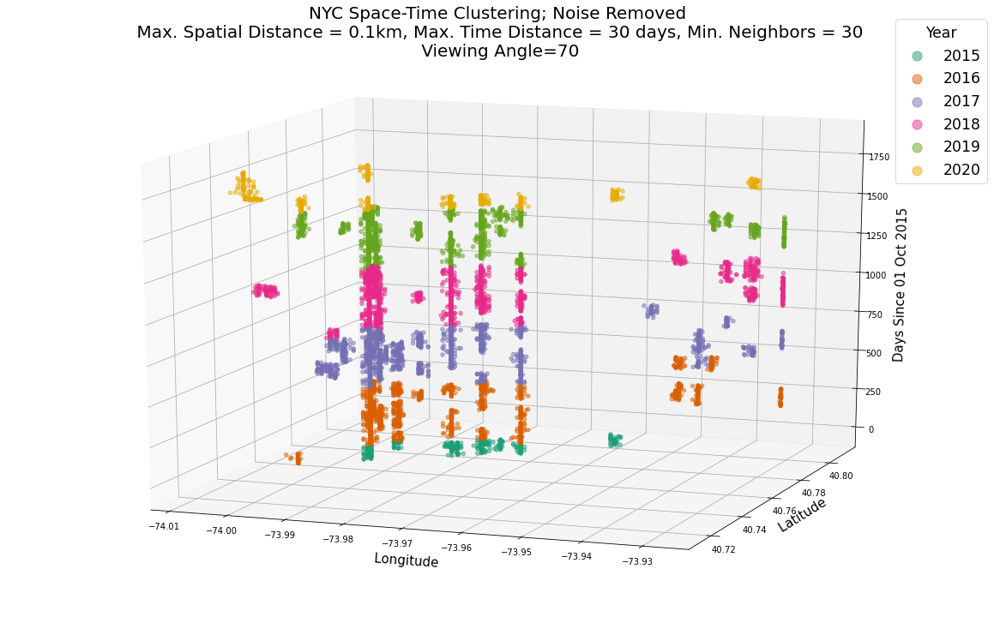

In [138]:
# Color Palette
color = ['#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02']

# Remove noise from each dataset
data = df_spatial_2016_MAH[df_spatial_2016_MAH[clust_id_col_name]!=-1]
data_2017 = df_spatial_2017_MAH[df_spatial_2017_MAH[clust_id_col_name]!=-1]
data_2018 = df_spatial_2018_MAH[df_spatial_2018_MAH[clust_id_col_name]!=-1]
data_2019 = df_spatial_2019_MAH[df_spatial_2019_MAH[clust_id_col_name]!=-1]
data_2020 = df_spatial_2020_MAH[df_spatial_2020_MAH[clust_id_col_name]!=-1]
data_2015 = df_spatial_2015_MAH[df_spatial_2015_MAH[clust_id_col_name]!=-1]

# Show the latitude and longitude in 3-D graph of each cluster
## Generate the median latitude, longitude and time distance of each cluster
data_2015_cluster = data_2015.groupby(clust_id_col_name)[['Latitude','Longitude','TimeDist']].median().reset_index()
data_2016_cluster = data.groupby(clust_id_col_name)[['Latitude','Longitude','TimeDist']].median().reset_index()
data_2017_cluster = data_2017.groupby(clust_id_col_name)[['Latitude','Longitude','TimeDist']].median().reset_index()
data_2018_cluster = data_2018.groupby(clust_id_col_name)[['Latitude','Longitude','TimeDist']].median().reset_index()
data_2019_cluster = data_2019.groupby(clust_id_col_name)[['Latitude','Longitude','TimeDist']].median().reset_index()
data_2020_cluster = data_2020.groupby(clust_id_col_name)[['Latitude','Longitude','TimeDist']].median().reset_index()

## For displaying in 3-D graph, round up the coordinates for easy reading
a=5
data_2015_cluster['string'] = round(data_2015_cluster['Latitude'],a).astype('str') + ' , \n ' + round(data_2015_cluster['Longitude'],a).astype('str') 
data_2016_cluster['string'] = round(data_2016_cluster['Latitude'],a).astype('str') + ' , \n ' +round(data_2016_cluster['Longitude'],a).astype('str') 
data_2017_cluster['string'] = round(data_2017_cluster['Latitude'],a).astype('str') + ' , \n ' +round(data_2017_cluster['Longitude'],a).astype('str')
data_2018_cluster['string'] = round(data_2018_cluster['Latitude'],a).astype('str') +' , \n ' + round(data_2018_cluster['Longitude'],a).astype('str')
data_2019_cluster['string'] = round(data_2019_cluster['Latitude'],a).astype('str') + ' , \n ' +round(data_2019_cluster['Longitude'],a).astype('str') 
data_2020_cluster['string'] = round(data_2020_cluster['Latitude'],a).astype('str') + ' , \n ' +round(data_2020_cluster['Longitude'],a).astype('str')

# Plot 3-D graph
fig = plt.figure(1, figsize=(8, 5))
angle = -70 # Adjust angles
ax = Axes3D(fig, rect=[0, 0, 2, 2], elev=15, azim=angle) # change parameters here for experimenting
ax.scatter(data_2015['Longitude'], data_2015['Latitude'], data_2015['TimeDist'], c=color[0], alpha=0.5,label=2015)
ax.scatter(data['Longitude'], data['Latitude'], data['TimeDist'], c=color[1], alpha=0.5,label=2016)
ax.scatter(data_2017['Longitude'], data_2017['Latitude'], data_2017['TimeDist'], c=color[2], alpha=0.5,label=2017)
ax.scatter(data_2018['Longitude'], data_2018['Latitude'], data_2018['TimeDist'], c=color[3], alpha=0.5,label=2018)
ax.scatter(data_2019['Longitude'], data_2019['Latitude'], data_2019['TimeDist'], c=color[4], alpha=0.5,label=2019)
ax.scatter(data_2020['Longitude'], data_2020['Latitude'], data_2020['TimeDist'], c=color[5], alpha=0.5,label=2020)

# Adjust year to show text
#for id, row in data_2020_cluster.iterrows():
#    ax.text(row['Longitude'],row['Latitude'],row['TimeDist'],row['string'])

plt.title('NYC Space-Time Clustering; Noise Removed \n Max. Spatial Distance = {}km, Max. Time Distance = {} days, Min. Neighbors = {} \n Viewing Angle={} '.format(s,temporal_dist_max,n_neighbours,abs(angle)), fontsize = 20)
plt.legend(fontsize='xx-large',markerscale=2.5,title='Year',title_fontsize='xx-large')
plt.ylabel('\n Latitude \n',fontsize=15)
plt.xlabel('\n Longitude',fontsize=15)

xtick = ax.get_xticks()
ax.set_xticks(xtick, minor=True)
ax.set_zlabel('\n Days Since 01 Oct 2015 ',fontsize=15) # ADjust font size
plt.show()
fig.savefig('Fig\Space_Time_Cluster.jpg')